# Loading Libraries 

In this stage we will be installing and importing all of the libraries and their dependencies that we require to conduct our netwokr analysis and recomendations system. 

In [1]:
import os
import requests
import numpy as np
import re
import pandas as pd
import networkx as nx
import seaborn as sns
import random
from statsmodels.distributions.empirical_distribution import ECDF
import matplotlib.pyplot as plt
import warnings
from pyvis.network import Network
from functools import reduce
import networkx.algorithms.community as nx_comm
import community.community_louvain as community_louvain
import matplotlib.cm as cm
from collections import Counter
from numpy import triu
from gensim.models.word2vec import Word2Vec
from node2vec import Node2Vec

warnings.filterwarnings("ignore", category=RuntimeWarning)


# Loading the Dataset

For this project we will be using the Facebook Pages for TV shows of mutually liked facebook pages. The nodes represent the pages and the edges represented mutual likes amongst them. The data collected in November 2017 with undirected edges. In this section we will be loading the dataset and conducting preliminary checks to handle any discrepancies, such as missing values, duplicates, missing nodes that are present in the edges but do not appear in the nodes dataset. 

In [2]:
# Set the seed for reporducibility
random.seed(123)

In [26]:
base_url = "https://raw.githubusercontent.com/hn11-44/Network-Science-Facebook-TV-Shows/main/data/"
nodes_url = base_url + 'fb-pages-tvshow.nodes'
edges_url = base_url + 'fb-pages-tvshow.edges'

In [28]:
nodes = pd.read_csv(nodes_url)
edges = pd.read_csv(edges_url, names = ["source", "target"])

In [29]:
nodes.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 3881 entries, 0 to 3880
Data columns (total 3 columns):
 #   Column  Non-Null Count  Dtype 
---  ------  --------------  ----- 
 0   id      3881 non-null   int64 
 1   name    3881 non-null   object
 2   new_id  3881 non-null   int64 
dtypes: int64(2), object(1)
memory usage: 91.1+ KB


Our nodes data has 3881 entries and so far we can see that we do not have any non-null. We have three different features stored in the dataset with the name of the show being included as an object type. Let us see the firt five rows in order to conceptualize what is stored in the data set. 

In [6]:
nodes.head()

,id,name,new_id
0,183215455178728,Orange is the New Black,1852
1,282808121926963,狮城有约 Hello Singapore,592
2,179653538737148,DC Cupcakes,1370
3,162816367111296,Gladiatorerna,1263
4,134115896703387,Globo Rural,3042


The first five values show us thhat the id of our instance, the name and the new_id for each instance. For now it is not clear which one we would be using to identify the node, basically it is not clear which one is the node id that would enable us to uniquely identify the nodes by. For now we suspect that the new_id would be the better representation as it falls within the range of the maximum rows within the dataset. But to double down on this hunch we should inspect what is in the edge dataset.  

In [8]:
edges.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 17262 entries, 0 to 17261
Data columns (total 2 columns):
 #   Column  Non-Null Count  Dtype
---  ------  --------------  -----
 0   source  17262 non-null  int64
 1   target  17262 non-null  int64
dtypes: int64(2)
memory usage: 269.8 KB


For the edge data set we can see we have the source and the target as the features. Whether we switch the name of the features will not be a problem as long as we are dealing with an undirected graph. However, if we were dealing with a directed graph the source and the target are important to determine which is the in-going and out-going link of a node. So let us inspect the first five values to better conceptualize what is within the data set. We should note that the features are integers and thus we will be dealing with the node ids and this will help us determine which one is the appropriate node id to use when representing our nodes to build our graphs. 

In [13]:
edges.head()

,source,target
0,0,1838
1,0,1744
2,0,14
3,0,2543
4,1,1009


Just to gain an intution on what is represented — we can see that node 0 is connected to 1838, 1744, 14 and 2543. This means that as we have suspected that the new_id feature in the node dataset will best represent the id for our nodes. Now let us continue exploring the dataset a bit further and get some reports on the shape of the dataset, the missing values, and check if we have any duplicates and if we have any nodes that are present within the edges list but not listed in the nodes data set because this can cause problems when we are building our networks. 

In [9]:
print("Shape of Dataset")
print("--"*18)
print("The shape of the nodes:", nodes.shape)
print("The shape of the edges:", edges.shape)

Shape of Dataset
------------------------------------
The shape of the nodes: (3881, 3)
The shape of the edges: (17262, 2)


In [10]:
print("Missing Values")
print("--"*20)
print("Missing Values for Nodes:\n", nodes.isna().sum())
print("Missing Values for Egdes:\n", edges.isna().sum())

Missing Values
----------------------------------------
Missing Values for Nodes:
 id        0
name      0
new_id    0
dtype: int64
Missing Values for Egdes:
 source    0
target    0
dtype: int64


In [11]:
print("Duplicated Values")
print("--"*20)
print("Node Duplicated Values:", nodes.duplicated().sum())
print("Edges Duplicated Values:", edges.duplicated().sum())

Duplicated Values
----------------------------------------
Node Duplicated Values: 0
Edges Duplicated Values: 0


To summarise the preliminary checks we can see nodes we have 3881 instances with 3 features representing the id of the node and the name of the node. For the edges we have 17262 with 2 features, representing the source and the traget of the link for the undirected graph. 

Further more we can see that we do not have any missing values and no duplicates for the dataset. In the next phase we will be cleaning our dataset or make it so that we can build some graph. But it is worth checking if we have some names that might be duplicated. 

In [12]:
nodes[nodes.duplicated('name')].head()

,id,name,new_id
100,119516159391,SportsCenter ESPN,3585
651,1403983956513471,SportsCenter ESPN,2192
896,361693253983770,三立華劇,3645
922,859371300812517,三立華劇,2711
1519,1031174333634374,Stranger Things,2756


We can see that we have some values in the names that are duplicated. for example, "SportCenter ESPN" has two values with two different new_id so we will be using a way to make the name unique by adding a suffix. For example, for the second "Sportscenter ESPN" with the new_id 2129, it would be named "SportsCenter ESPN2" and if there would be third one then we would increment the suffix by one. 

# Cleaning To Build Graph

In the following steps we will gather all of the things we need from the dataset to create graphs. We will start by creating a function that is called make_node_names_unique and it will help us to create a suffic for the duplicated values that we have seen in the preliminary stage of checking our dataset. 

In [14]:
# Create a function that would a suffix for each of the names that have duplicates 
def make_node_names_unique(df, column):
    """Make all the items unique by adding a suffix (1, 2, etc).

    `df` is your DataFrame.
    `column` is the column of interest.
    """
    counts = df[column].value_counts()
    duplicates = counts[counts > 1].index.tolist()

    for value in duplicates:
        suffix = 1
        mask = df[column] == value
        ind = df[mask].index
        for i in ind[1:]:
            df.loc[i, column] = df.loc[i, column] + str(suffix)
            suffix += 1

In [15]:
#Use the function and insert the dataframe in our case nodes, and the column name
make_node_names_unique(nodes, "name")

In [16]:
#Inspect if our make_node_names_unique function works well
nodes[nodes['name'].apply(lambda x: bool(re.search(r"SportsCenter ESPN.*", x)))]

,id,name,new_id
83,1389913481260530,SportsCenter ESPN,1624
100,119516159391,SportsCenter ESPN1,3585
651,1403983956513471,SportsCenter ESPN2,2192
1796,480557468719616,SportsCenter ESPN3,3099
2381,346268925423309,SportsCenter ESPN4,1722


We can see that adding our suffix has worked and in feact we have a total of 5 instances with the name of the "SportsCenter ESPN" that are verified facebook pages. Then we will be creating a dictionary for the names and the node based on the new_id feature. This will be useful for us to get the name associated with a give id of the node.

In [17]:
# Create a nodes_dict which contain the id of the node and the corresponding name
nodes_dict = {id: n for (n, id) in zip(nodes["name"], nodes["new_id"])}

In [18]:
#Inspect the firt five items (key, value) of the nodes_dict variable
list(nodes_dict.items())[0:5]

[(1852, 'Orange is the New Black'),
 (592, '狮城有约 Hello Singapore'),
 (1370, 'DC Cupcakes'),
 (1263, 'Gladiatorerna'),
 (3042, 'Globo Rural')]

We can see that the items of our nodes_dict align with the values in the nodes dataset and give us the node id as a key and the name of the show as vlaues. This will come in handy in the following steps when we will begin building our graph and we use the edges to build the graph and use the dictionary we have created to label them with the node names. So the corresponding links between edges that contain the source node and the target node will be labeled with the names. 

# Building the Graph

In [19]:
# Create the graph
G = nx.from_pandas_edgelist(edges, source='source', target='target', create_using=nx.Graph())

# Exclude self-loops
G.remove_edges_from(nx.selfloop_edges(G))

# Relabel the nodes
mapping = dict(zip(nodes["new_id"], nodes["name"]))
G = nx.relabel_nodes(G, mapping)

print(f"Number of nodes {G.number_of_nodes()} - Number of links: {G.number_of_edges()}")

Number of nodes 3892 - Number of links: 17239


In this sectio we have built our graph using the edges data frame which contains the columns source and target of our undirected network. Furthermore we have excluded self-lopps in the graph and created a mapping that would enable us to label the node with the names of the TV-shows. Overall we have 3892 nodes and 17239 links. 

# Visualization

In this section we will use some visualization technique that would enable us to get a glimpse of the sturcture of the network.

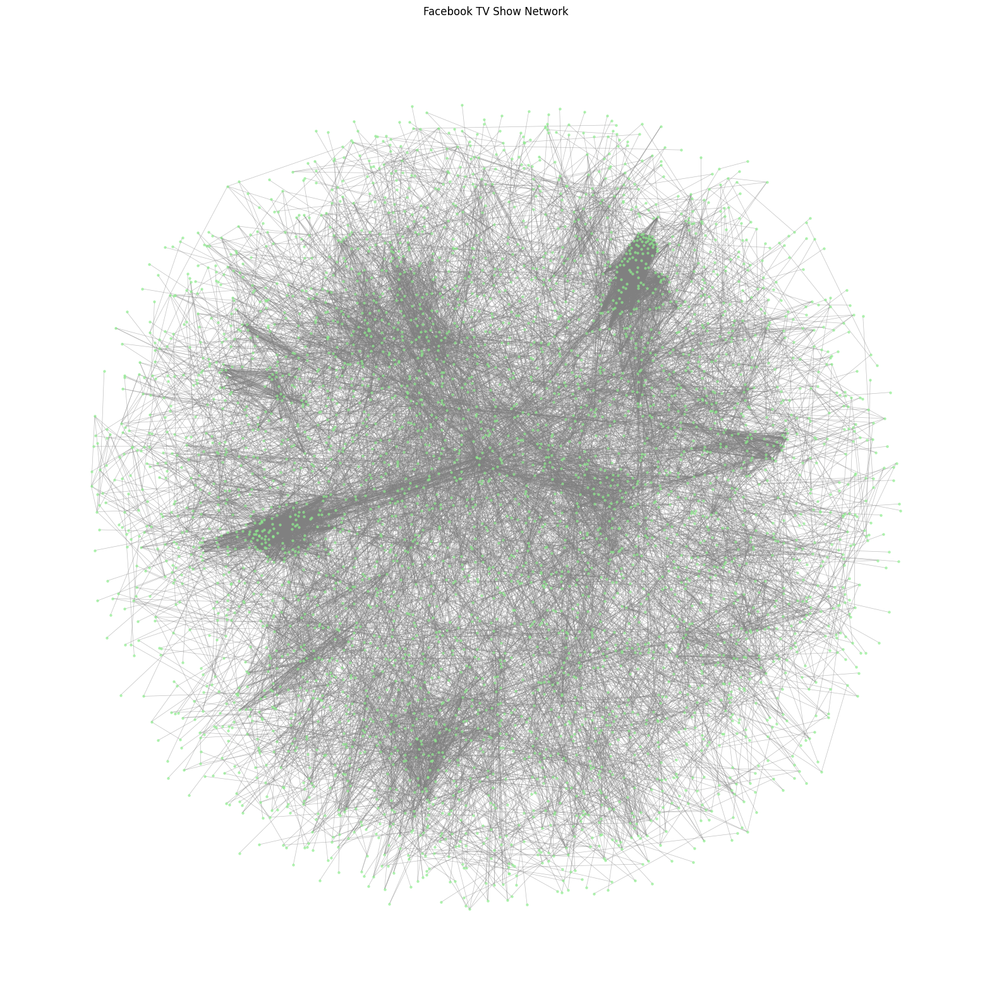

In [20]:
# Now visualize the subgraph
pos = nx.spring_layout(G, k = 0.15)
plt.figure(figsize=(20,20))
nx.draw_networkx_nodes(G, pos, node_size = 5, label = False, alpha = 0.6, node_color = 'lightgreen')
nx.draw_networkx_edges(G, pos, alpha = 0.5, width = 0.5, edge_color = 'grey')
plt.title('Facebook TV Show Network')
plt.axis('off')
plt.show()

/Users/h/Documents/School/Data Science for Economics/Semester 3/Network Science/Project/Final Project/network_project/lib/python3.10/site-packages/IPython/core/pylabtools.py:170: UserWarning: Glyph 26143 (\N{CJK UNIFIED IDEOGRAPH-661F}) missing from current font.
  fig.canvas.print_figure(bytes_io, **kw)
/Users/h/Documents/School/Data Science for Economics/Semester 3/Network Science/Project/Final Project/network_project/lib/python3.10/site-packages/IPython/core/pylabtools.py:170: UserWarning: Glyph 26399 (\N{CJK UNIFIED IDEOGRAPH-671F}) missing from current font.
  fig.canvas.print_figure(bytes_io, **kw)
/Users/h/Documents/School/Data Science for Economics/Semester 3/Network Science/Project/Final Project/network_project/lib/python3.10/site-packages/IPython/core/pylabtools.py:170: UserWarning: Glyph 20108 (\N{CJK UNIFIED IDEOGRAPH-4E8C}) missing from current font.
  fig.canvas.print_figure(bytes_io, **kw)
/Users/h/Documents/School/Data Science for Economics/Semester 3/Network Science/Pr

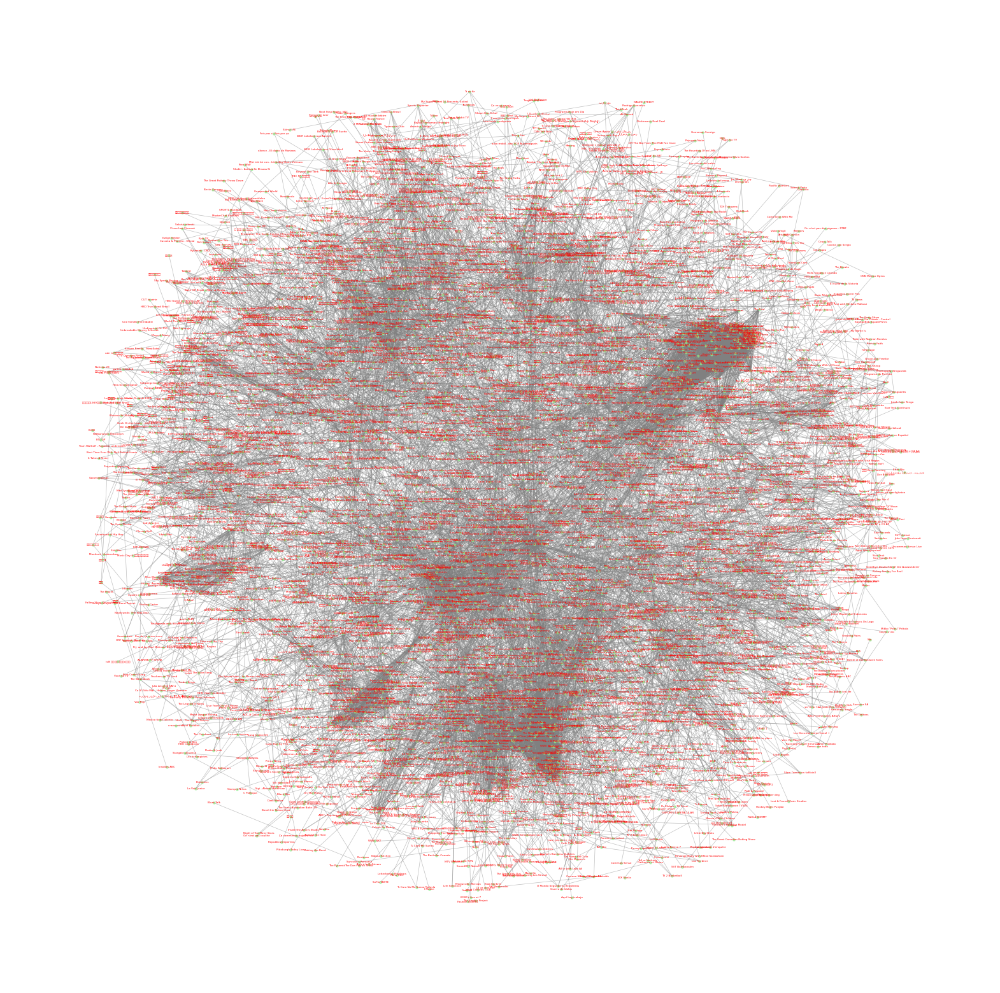

In [21]:
warnings.filterwarnings("ignore", category=RuntimeWarning)

# draw the graph with labels
pos = nx.spring_layout(G, k = 0.15)
plt.figure(figsize=(20,20))

nx.draw_networkx_nodes(G, pos, node_size = 5, alpha = 0.6, node_color = 'lightgreen', label = 'name')
nx.draw_networkx_edges(G, pos, alpha = 0.5, width = 0.5, edge_color = 'grey')
nx.draw_networkx_labels(G,pos,font_size=3,font_color='r')
plt.axis("off")
plt.show()

Now that we have visualised the graph and we can see that we have one component just off of the visualisation so we will be using a much more complex visualisation and computational method in order to confirm our hunch. Just through the visualization we cannot extract anything that could be inisghtful. Let us see more visualisation we could conduct before we begin our analysis. 

### Visualisation of Ego Networks and Entire Network with Hubs

We start with the node-level analysis by assessing the degree centrality. This would enble us to determine the number of connection of each node and enable us to identify the nodes that have the largest number of connection, in other workd the most central node in the network. The process is very simple we focus on counting the number of edges that a node has. 

In [22]:
# We create a data frame from the the degree dictionary of graph G. The DateFrame hs an index and a column 'degree'
node_degree_df =  pd.DataFrame.from_dict(dict(G.degree()),orient="index", columns=['degree']).reset_index()
# Rename the column of the DataFrame 'name' and 'degree'
node_degree_df.columns = ["name", "degree"]
# We then merge the 'nodes' Dataframe with 'node_deg_df' DataFrame based on the 'name' column
node_degree_df = nodes.merge(node_degree_df, on = "name")
# We finally sort the DataFrame in descending order based on the 'degree' column
node_degree_df = node_degree_df.sort_values(by='degree', ascending=False)
# We display our result
node_degree_df

,id,name,new_id,degree
358,888804631233671,Queen of the South,3254,126
1599,344485392298301,Home & Family,2008,126
3403,9748634303,So You Think You Can Dance,3525,108
3445,55482772043,Glee,1177,104
831,222039131156080,New Girl,1673,102
...,...,...,...,...
827,1810158785906918,Hood Adjacent,1021,1
2399,224505914302254,"Bom dia Amazônia, Jornal do AC e G1 AC",3777,1
3202,540350446139282,Un camino hacia el destino,1551,1
1801,127586940769806,Guy Court,2604,1


As we can see thos determines the nodes in our case the shows that have the most mutually liked. Based off of the result we can create an ego network for the top three shows that are mutually liked in order to get an idea of how it connected.

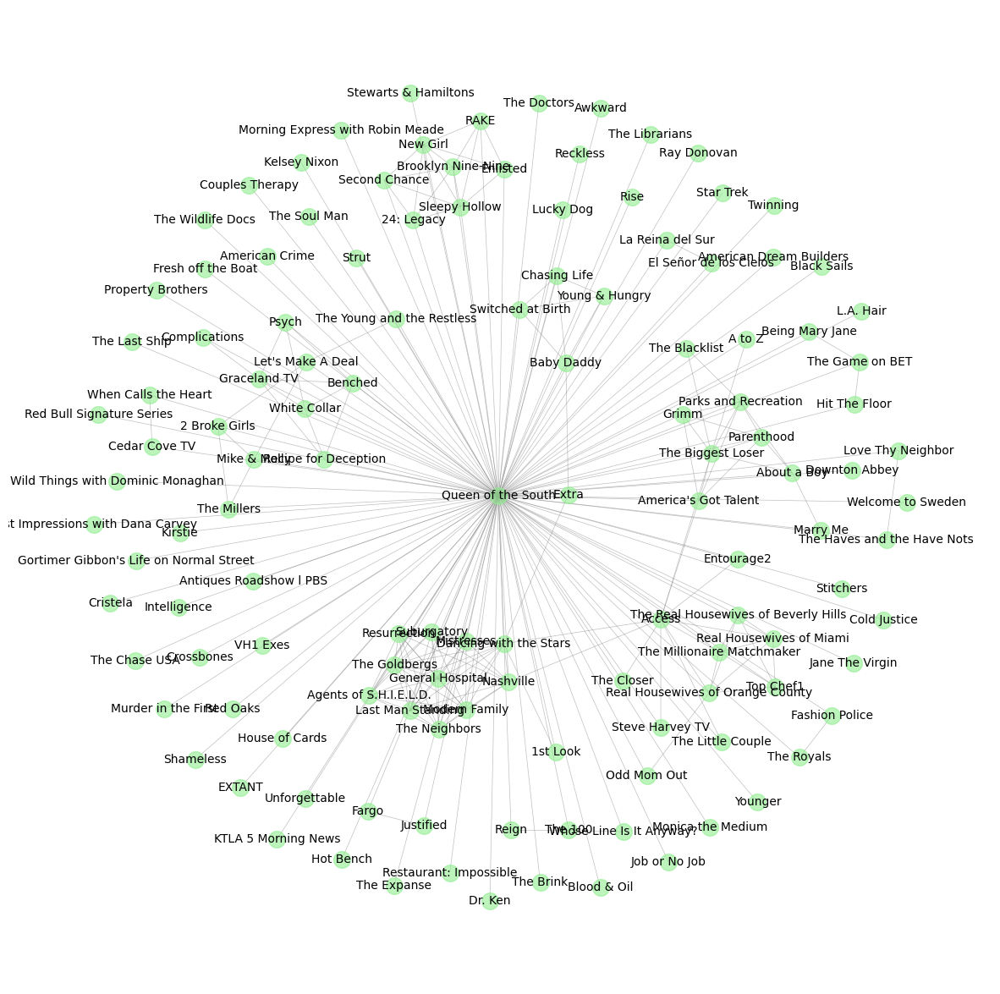

In [23]:
# Basing on our G network and the 'Queen of South' node we create an ego graph
ego_network_queen_south = nx.ego_graph(G, 'Queen of the South')

# We plot our ego_network_queen_south
plt.figure(figsize=(15, 15))  # Set the size of the figure
pos = nx.spring_layout(ego_network_queen_south, k = 0.15)  # Compute the positions of the nodes


nx.draw_networkx_nodes(ego_network_queen_south, pos, node_size = 200, alpha = 0.6, node_color = 'lightgreen', label = 'name')
nx.draw_networkx_edges(ego_network_queen_south, pos, alpha = 0.5, width = 0.5, edge_color = 'grey')


nx.draw_networkx_labels(ego_network_queen_south, pos, font_size=10)  # Draw the labels
plt.axis("off")
plt.show()

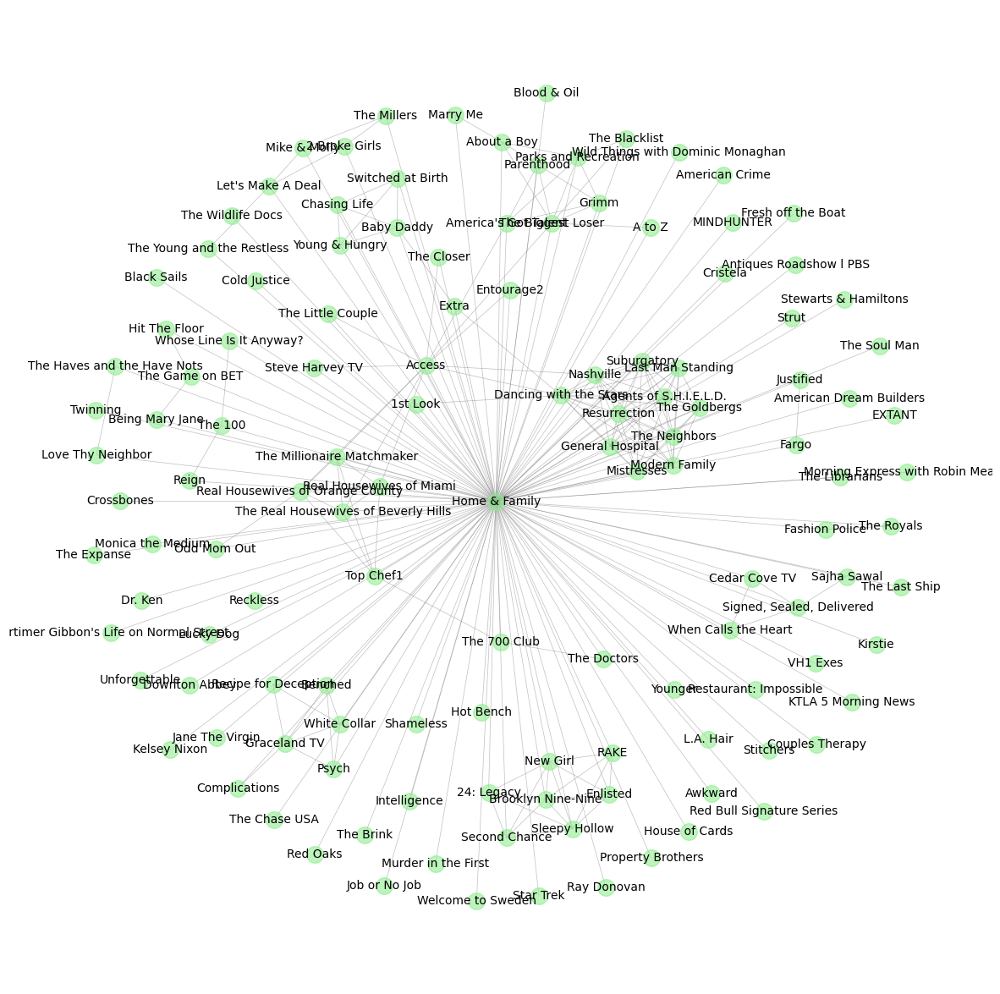

In [122]:
# Using our G network and 'Home & Family' node
ego_network_home_and_family = nx.ego_graph(G, 'Home & Family')

# We build our ego network graph 
plt.figure(figsize=(15, 15))  # Set the size of the figure
pos = nx.spring_layout(ego_network_home_and_family)  # Compute the positions of the nodes

nx.draw_networkx_nodes(ego_network_home_and_family, pos, node_size = 200, alpha = 0.6, node_color = 'lightgreen', label = 'name') #Draw the nodes
nx.draw_networkx_edges(ego_network_home_and_family, pos, alpha = 0.5, width = 0.5, edge_color = 'grey') #Draw the edges
nx.draw_networkx_labels(ego_network_home_and_family, pos, font_size=10)  # Draw the labels
plt.axis('off')

plt.show()

/Users/h/Documents/School/Data Science for Economics/Semester 3/Network Science/Project/Final Project/network_project/lib/python3.10/site-packages/IPython/core/pylabtools.py:170: UserWarning: Glyph 48121 (\N{HANGUL SYLLABLE MIG}) missing from current font.
  fig.canvas.print_figure(bytes_io, **kw)
/Users/h/Documents/School/Data Science for Economics/Semester 3/Network Science/Project/Final Project/network_project/lib/python3.10/site-packages/IPython/core/pylabtools.py:170: UserWarning: Glyph 49828 (\N{HANGUL SYLLABLE SEU}) missing from current font.
  fig.canvas.print_figure(bytes_io, **kw)
/Users/h/Documents/School/Data Science for Economics/Semester 3/Network Science/Project/Final Project/network_project/lib/python3.10/site-packages/IPython/core/pylabtools.py:170: UserWarning: Glyph 45208 (\N{HANGUL SYLLABLE NA}) missing from current font.
  fig.canvas.print_figure(bytes_io, **kw)
/Users/h/Documents/School/Data Science for Economics/Semester 3/Network Science/Project/Final Project/ne

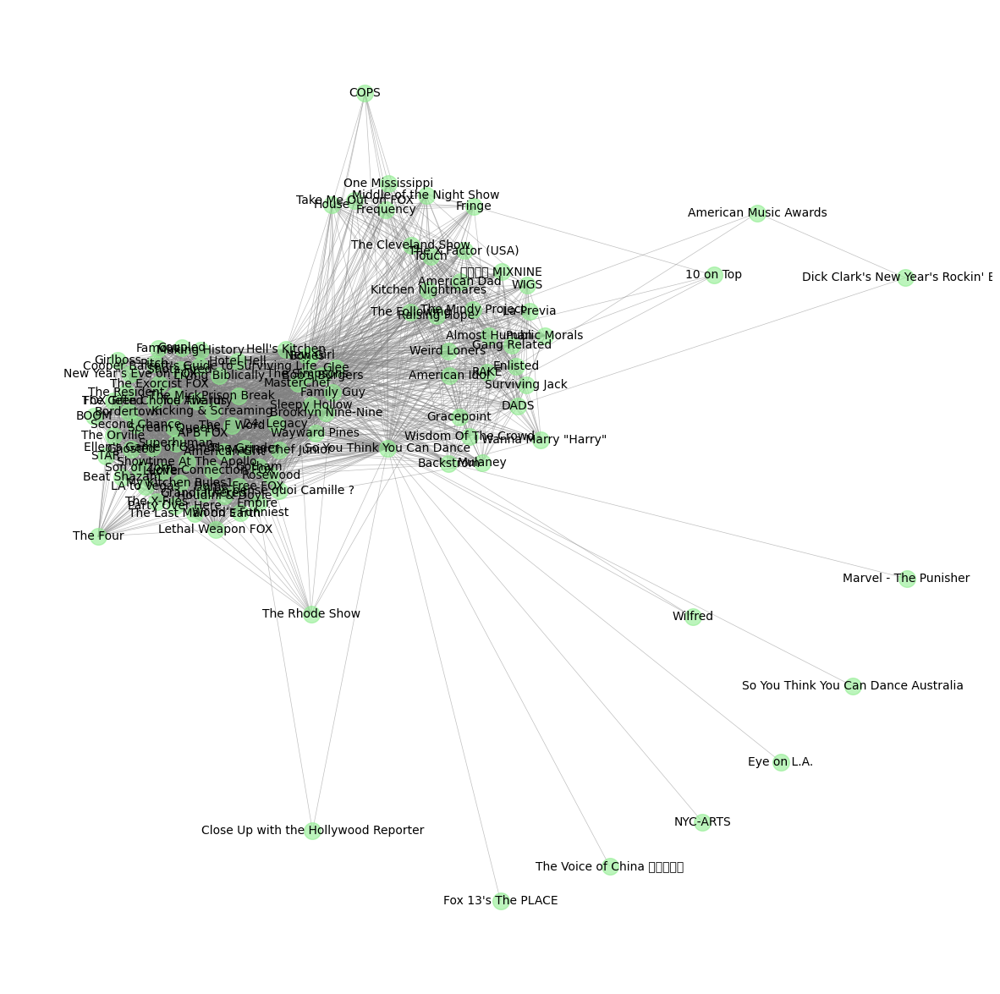

In [24]:
# Using G as our network and basing on the 'So You Think You Can Dance'
ego_network_so_you_think_you_can_dance = nx.ego_graph(G, 'So You Think You Can Dance')

# Using the network we have created 'ego_networl_so_you_think_you_can_dance'
plt.figure(figsize=(15, 15))  # Set the size of the figure
pos = nx.spring_layout(ego_network_so_you_think_you_can_dance)  # Compute the positions of the nodes

nx.draw_networkx_nodes(ego_network_so_you_think_you_can_dance, pos, node_size = 200, alpha = 0.6, node_color = 'lightgreen', label = 'name') #Draw the nodes
nx.draw_networkx_edges(ego_network_so_you_think_you_can_dance, pos, alpha = 0.5, width = 0.5, edge_color = 'grey') #Draw the edges
nx.draw_networkx_labels(ego_network_so_you_think_you_can_dance, pos, font_size=10)  # Draw the labels
plt.axis('off')
plt.show()

The visualisation of the ego networks for the nodes "Queen of South", "Home & Family" and "So You Think You Can Dance" indicates that these are the central nodes for all of the graphs above. The conncetion between the nodes represent the TV show pages that have mutual like with each show. We can see in the first two plots that some nodes are clustered indicating that they have high density of mutual likes within a subgroup. This could be cause of similar genres that are often watched by the same audience. In the last plot we can see that there is a high level of transitivity forming a cluster. 

In [25]:
# Assuming 'G' is your original graph and 'nodes' is your DataFrame of nodes
degree = dict(G.degree())
percentile_99 = np.percentile(list(degree.values()), 99)
hub_nodes = [node for node, deg in degree.items() if deg >= percentile_99]
names = list(nodes.name)

color_map = []
size_map = []
node_index = {}
for i in range(0, len(names)):
  if not (names[i] in hub_nodes):
    color_map.append('#86b5fb')  # Removed the extra quotes
    size_map.append(20)
  else:
    color_map.append('#93e685')
    size_map.append(200)  # Made hub nodes larger for emphasis

net = Network(notebook=True, font_color = 'black')
# set the physics layout of the network
net.force_atlas_2based(gravity=-300,spring_length=300)

# Add nodes to the network
for node, color, size in zip(G.nodes(), color_map, size_map):
    title = node if node in hub_nodes else ""  # Only add title for hub nodes
    net.add_node(str(node), title=title, color=color, size=size)

# Add edges to the network
for edge in G.edges():
    src = str(edge[0])
    dst = str(edge[1])
    if src in net.get_nodes() and dst in net.get_nodes():
        net.add_edge(src, dst)

# Show the network
net.show("base_network1.html")


base_network1.html


In [22]:
degree = list(dict(G.degree()).values())
percentile_99 = np.percentile(degree, 99)
hub_node = [k for k,v in dict(G.degree()).items() if v>= percentile_99]
names = list(nodes.name)
color_map = []
size_map = []
node_index = {}
for i in range(0, len(names)):
  if not (names[i] in hub_node):
    color_map.append("'#86b5fb'")
    size_map.append(20)
  else:
    color_map.append('#93e685')
    size_map.append(200)
    
    
net = Network(bgcolor='#222222', font_color='white', notebook =True)

# set the physics layout of the network
net.force_atlas_2based(gravity=-300,spring_length=300)

# Add nodes to the network
node_ids = node_degree_df['new_id'].tolist()
node_sizes = node_degree_df['degree'].tolist()
node_titles = node_degree_df['name'].tolist()
node_labels = node_degree_df['name'].tolist()
net.add_nodes(node_ids, size=node_sizes, title=node_titles, label=node_labels, color=color_map)

# Add edges to the network
for index, row in edges.iterrows():
    src = int(row['source'])
    dst = int(row['target'])
    if src in node_ids and dst in node_ids:
        net.add_edge(src, dst)
        
        
net.options.nodes ={"font" : {
          "size" : 50,
          "color" : '#ffffff'
      }}


net.show('base_network2.html')


base_network2.html


# Network-Level Analysis 

In this section we will inspecting the network in it enterity. We will start by assessing the component(s) that are within the network, isolated nodes, the core and the periphery. 


### Component/Isolates

Component is a set of nodes that are internally connected and where any two vertices are connected to each other by paths — every node can reach every other node in the same component via some path. If a node is isolated from other nodes, it is simply referred to as an isolate, a node with no connection. So we will start by checking if every pair of node in the graph is connected and then we will fetch the number of connected components within our graph. Then we will proceed to check if we have any isloates just as a way to confirm our results.

In [26]:
# Check if every node within our graph is connected
print("Is every node connected within our graph G:", nx.is_connected(G))
# Fetch the number of connected components within our graph G
print("Number of Components in G:", nx.number_connected_components(G))
# Check if there are any isolates within the graph
print("How many isolates we have in our graph G:", len(list((nx.isolates(G)))))


Is every node connected within our graph G: True
Number of Components in G: 1
How many isolates we have in our graph G: 0


As we can see from our graph every pair of node is connected and we have no isolates. This indicates that Facebook pages for TV Show are all part of a single, interconnected community. The fact that there are no isolates indictaes that each node has at least one mutual like with another page.

### Core/Periphery

In this section we will assessing the network cores, these are the members that are densly tied to each other. On the other hand the nodes in the periphery are more linked to the core members than to each other. Eventhough we will not be analysing the temporal structural transformation of the network, we would like to assess the core of the network and the periphery. Usually the shows in the periphery represent emerhing trends or that are catering to a niche interest. This will not be our main interest but nevertheless we would like to assess it to get an understanding and visualise what the core and the periphery look like. 

/Users/h/Documents/School/Data Science for Economics/Semester 3/Network Science/Project/Final Project/network_project/lib/python3.10/site-packages/IPython/core/pylabtools.py:170: UserWarning: Glyph 26143 (\N{CJK UNIFIED IDEOGRAPH-661F}) missing from current font.
  fig.canvas.print_figure(bytes_io, **kw)
/Users/h/Documents/School/Data Science for Economics/Semester 3/Network Science/Project/Final Project/network_project/lib/python3.10/site-packages/IPython/core/pylabtools.py:170: UserWarning: Glyph 26399 (\N{CJK UNIFIED IDEOGRAPH-671F}) missing from current font.
  fig.canvas.print_figure(bytes_io, **kw)
/Users/h/Documents/School/Data Science for Economics/Semester 3/Network Science/Project/Final Project/network_project/lib/python3.10/site-packages/IPython/core/pylabtools.py:170: UserWarning: Glyph 20108 (\N{CJK UNIFIED IDEOGRAPH-4E8C}) missing from current font.
  fig.canvas.print_figure(bytes_io, **kw)
/Users/h/Documents/School/Data Science for Economics/Semester 3/Network Science/Pr

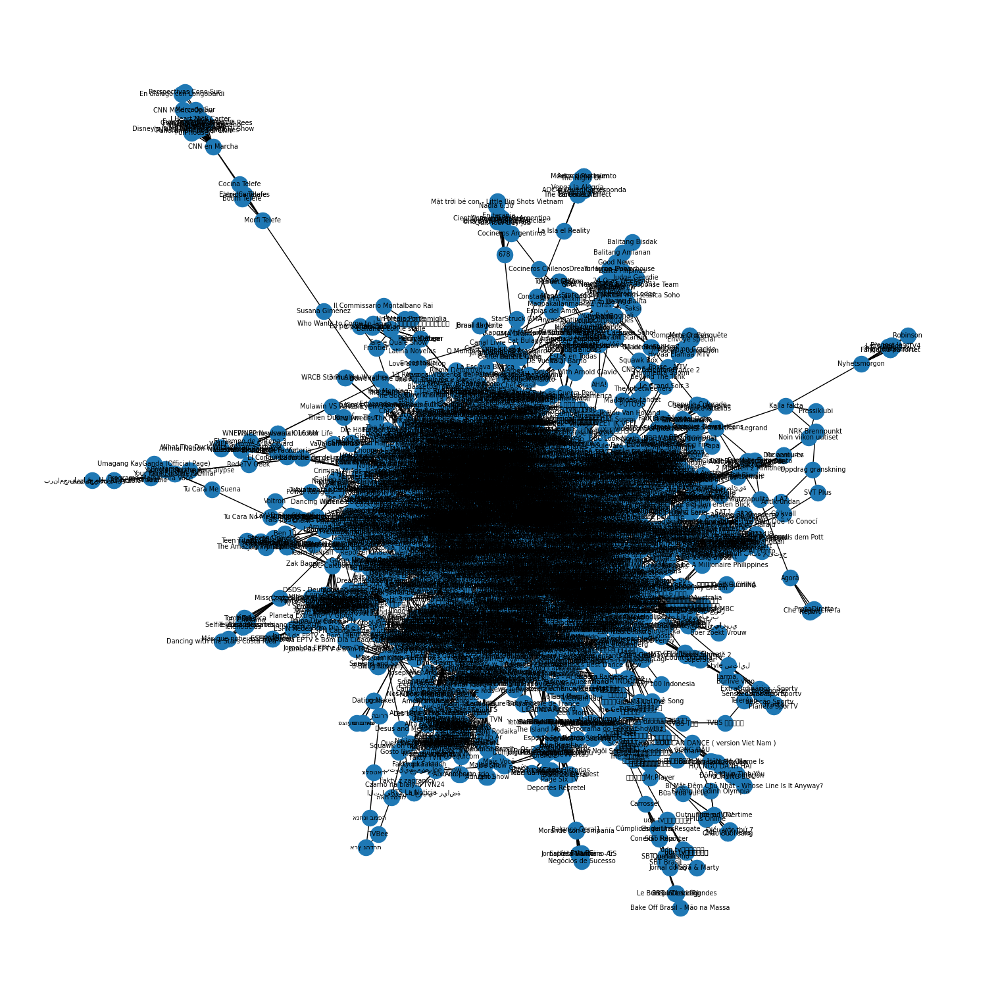

In [27]:
core = nx.k_core(G, k = 2)
plt.figure(figsize=(15, 15))  # Set the size of the figure
nx.draw(core, with_labels=True, font_size = 7)
plt.show()

/Users/h/Documents/School/Data Science for Economics/Semester 3/Network Science/Project/Final Project/network_project/lib/python3.10/site-packages/IPython/core/pylabtools.py:170: UserWarning: Glyph 48264 (\N{HANGUL SYLLABLE BEON}) missing from current font.
  fig.canvas.print_figure(bytes_io, **kw)
/Users/h/Documents/School/Data Science for Economics/Semester 3/Network Science/Project/Final Project/network_project/lib/python3.10/site-packages/IPython/core/pylabtools.py:170: UserWarning: Glyph 52376 (\N{HANGUL SYLLABLE CEO}) missing from current font.
  fig.canvas.print_figure(bytes_io, **kw)
/Users/h/Documents/School/Data Science for Economics/Semester 3/Network Science/Project/Final Project/network_project/lib/python3.10/site-packages/IPython/core/pylabtools.py:170: UserWarning: Glyph 51020 (\N{HANGUL SYLLABLE EUM}) missing from current font.
  fig.canvas.print_figure(bytes_io, **kw)
/Users/h/Documents/School/Data Science for Economics/Semester 3/Network Science/Project/Final Project/

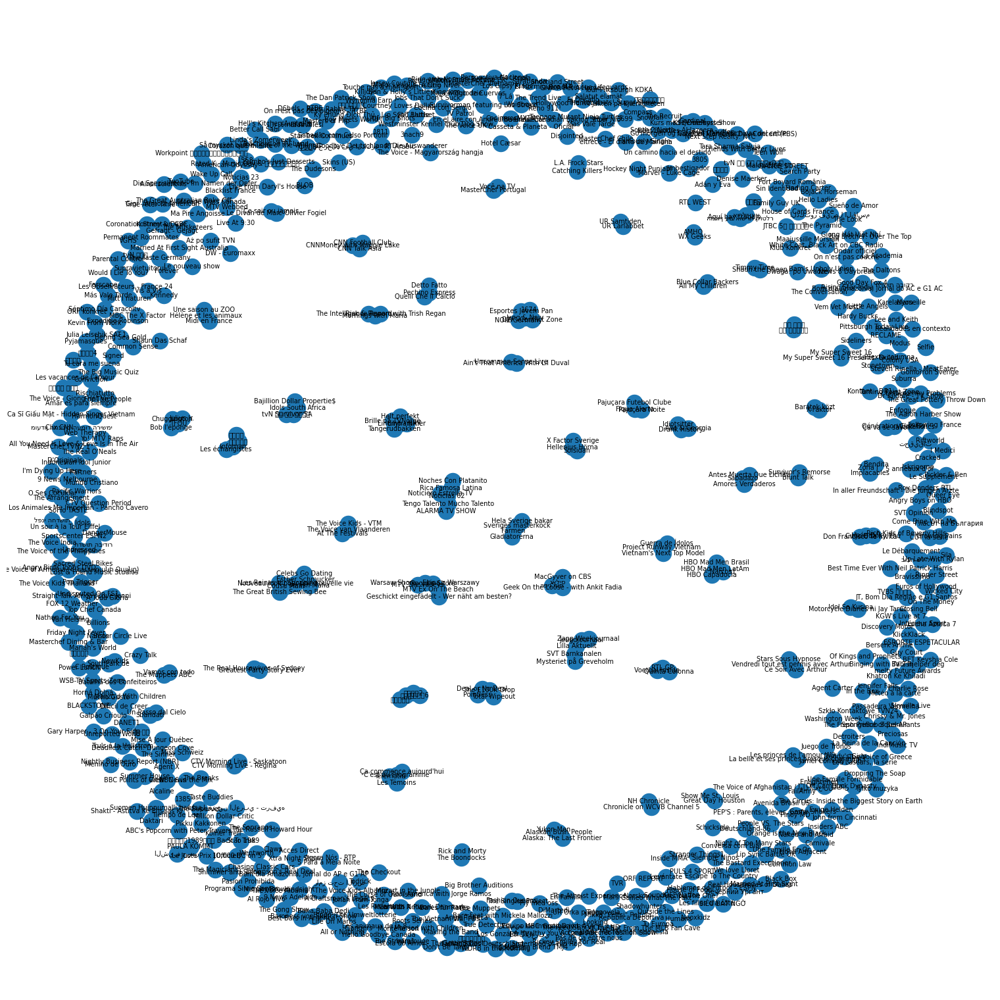

In [30]:
# Find the periphery of the network
periphery = nx.k_shell(G, k = 1)
plt.figure(figsize=(15, 15))  # Set the size of the figure
nx.draw(periphery, with_labels=True, font_size = 7)
plt.show()

### Density

The density of a network is the number of edges within the network divided by the maximum number of possible number of edges between nodes in the network. The value of the density takes on a value between 0 and 1. In our case this would represent the proportion of all possible mutual likes between paris of TV shows pages that actually exist and all the possible of mutual likes that could exist considering that all pages are mutually liked.

In [28]:
# We will get the density of the network and store it in the variable density
density = nx.density(G)
print("Graph Density:", density)

Graph Density: 0.0022767115088631815


While all nodes are connected, they are not densly interconnected. This means that while every TV show page has at least one mutul like with another page, not every page is mutually liked with every other page.
Only a small proportion of all possible mutual likes between paris of TV shows actually exists. 

Although there is a shared audience among the TV shows (as indicated by the mutual likes), the audience's interest are diverse. Not every viewer who like one TV show page necessarily likes all the others. 

### Path

The shortest paths, computes the legth of the shortest path between two nodes. This is usually done with Dijkstra's algorithm. If we are computing the opposit the longest distance in a graph it is called the diameter. This would enable us to determine how far aprat the two furthest nodes are in the network from each other. So in the next section we will compute the the average shortest path and the diameter of our graph. The path measurement provides detail on teh structure and connectivity of the network. 

In [30]:
# Compute the minimum path length between any two nodes 
print("Radius (Minimum Path Length):", nx.radius(G))
# Compute the avergae shortest path of the graph 
print("Average shortest path:", nx.average_shortest_path_length(G))
# Compute the diameter of the graph 
print("Diamater of the graph:", nx.diameter(G))

Radius: 11
Average shortest path: 6.275911443991629
Diamater of the graph: 20


Eccetricity of a node is the greatest distance between that node and any other node. And when we are considering the all of the nodes for the entire graph and calculate their eccentrictities and then find the smallest one, this is is the radius of the node. We have 11 as radius which means that we have at least one node in the graph that can reach all other nodes in 11 steps. This could mean that most centrally connected TV show's Facebook Page can reach any other TV show's Facebook Page within 11 steps through a relatively small number of mutual likes. 

The value of the average shortest path is 6.27 which means that on average the shortest path between two mutually liked TV shows in Facebook Page in the year of 2017 is approximately 6.27 steps. When we interpret this in layman terms it would mean that if a user starts with one TV show page and follows the mutual likes to another page, they would go through about 6 other pages on average. This could be indicative of the diverse interests users may have, because of less overlap in the audiences. 

Whereas the diameter of the graph is 20 hops, which means that the longest shortest path between any two TV show pages in our network is 20 steps. The furthest any two shows can be apart in terms of mutual likes is 20 steps. The two most distantly related TV show pages (in terms of mutual likes) are 20 steps apart. Again this reinforces that there are pais of TV show pages that cater to different audiences. 

### Transitvity

Transitvity will inspect the ratio of the number of triangles in the network (sets of nodes that are all connected to each other) to the number of connected triples of nodes (stes of three nodes with at least two connection between them). Basically we are inspecting the overall likelihood that the adjacent vertices of a vertx are connected to each other. This will enable us to determine if our network has a high clustering coefficient. 

In [291]:
print("Transitivity:", nx.transitivity(G))

Transitivity: 0.5906435656994041


Based on the result we can see that we have a moderate to high degree of clustering. This is indicative that the TV show in the Facebook Pages network tend to form clusters and this was also evident from the visualisation we conducted in the initial stage. This means that if a Facebook users like two TV shows pages, it's quite likely that those two TV shows are mutually liked. Furthermore, this shows similar tastes between users. This is a great indication for us to build a recommendation system later on. 

This could be a way for use to investigate further on the type of the shows that are liked so as to determine if the shows share a similar viewer base, maybe due to similarities in genre, language and cultural context. 

### Degree Assortativity

We will be analysing if network's nodes connect with similar nodes in some way. In our case we are looking at the degree assortativity coefficient which is the correlation between the degrees of all nodes on the opporite ends of a link. A positive coefficent inidcates that nodes to link to other nodes with similar degree, while negative coefficient suggest that nodes with high degree are connected to nodes with low degree. 


 Assortativity ranges from -1 to 1, with 1 being assortative and -1 being dissaortative, which menas that nodes of high degree tend to connect with nodes of low degree. 

In [31]:
# Calculate the degree assortativity of graph G
r = nx.degree_assortativity_coefficient(G)

print("The degree assortativity of graph G is: ", r)

The degree assortativity of graph G is:  0.5605396504711333


Results suggest that the degree of assortativity is approximatley 0.56 indicating moderate assotativty. Popular TV shows tend to be mutually liked with other popular TV shows. Similarly pages with fewer mutual likes (low degree) tend to be mutually liked with other pages that have fewer mutual likes. 

### Degree Distribution

When conducting our visualisation we have briefly seen we have computed the degree of each node and stored it in a data frame we named "node_degree_df". We used this data frame to build our ego network and also to build our pyvis network visualisation. Now we will utilise the degree centrality of a node which is the edges that is connected to a node. Using this detail we will build our a degree distribution. This will give us the probability distribution of the degree over the whole network. 

In [32]:
# Let us wee what our data frame looks like 
node_degree_df.head()

# # Count the frequency of each degree value
degree_counts = node_degree_df['degree'].value_counts().sort_index(ascending=False)



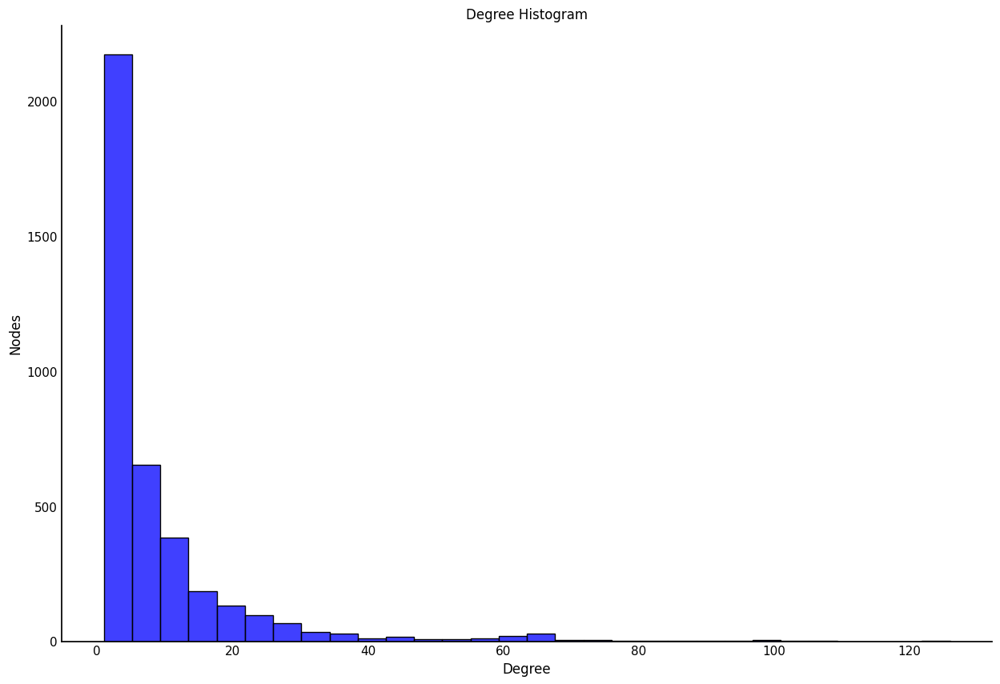

In [33]:
# Set the figure plote 
plt.figure(figsize=(15, 10))

# Set the context of the plot
sns.set_context("notebook")

# Create the histogram using Seaborn
sns.histplot(node_degree_df['degree'], bins=30, color='b')

# Set the title and labels
plt.title("Degree Histogram")
plt.ylabel("Nodes")
plt.xlabel("Degree")

# Remove major ticks
plt.gca().tick_params(axis='both', which='both', length=0)
plt.gca().set_facecolor('white')

# Remove the top and right axes
sns.despine()

# Show the plot
plt.show()


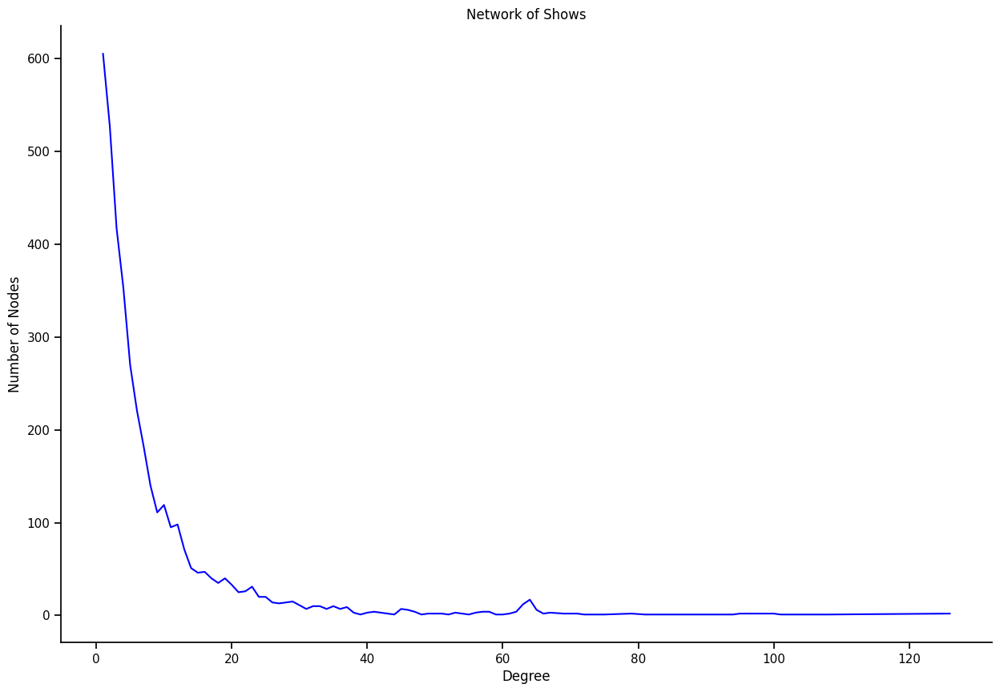

In [34]:
# Create the plot using Seaborn
plt.figure(figsize=(15, 10))
sns.lineplot(x=degree_counts.index, y=degree_counts.values, color='b')

# Set the title and labels
plt.title("Network of Shows")
plt.xlabel("Degree")
plt.ylabel("Number of Nodes")

# Remove the top and right axes
sns.despine()
# Show the plot
plt.show()

From the result we can see that that a large number of pages have a low degree, this indicataes that have few mutual likes with other pages. As the degre increases the number of pages decreases sharply, this suggest that only a few pages have a high number of mutual likes. And very few pages have a degree abover 20 indicating that it's rare for a page to have mutual like with more than 20 other pages. Based on our degree distribution we can see that the network exhibits a scale free characteristics where we have numerous few links and few nodes with high degree. 

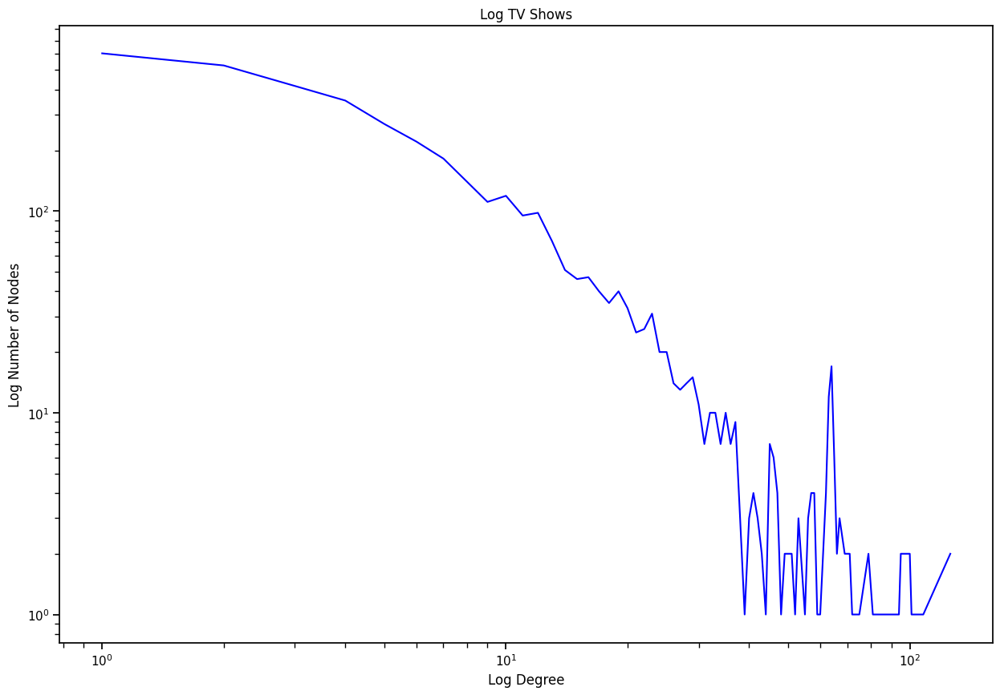

In [35]:
# Create the log-log plot using Seaborn
plt.figure(figsize=(15, 10))
sns.lineplot(x=degree_counts.index, y=degree_counts.values, color='b')

# Set the scale of x and y axes to logarithmic
plt.xscale('log')
plt.yscale('log')


# Set the title and labels
plt.title("Log TV Shows")
plt.xlabel("Log Degree")
plt.ylabel("Log Number of Nodes")

# Show the plot
plt.show()

This plot shows us that the x-axis and the y-axis in the logarithmic form. We can again confirm that there are a few nodes with very high degree (hubs) and many nodes with low degree. 

### ECDF & ECCDF

In this section we use the Empirical Cumulative Distribution Function (ECDF)  and ECCDF as a way to visualise and analyse the distribution of the data points. The ECDF gives us a way to examine the probability that a random variable is less than or equal to a certain value. Where as the ECCDF is simply one minus the ECDF enable using to represent that a random variable is greater than a certain value or equal to certain value. 

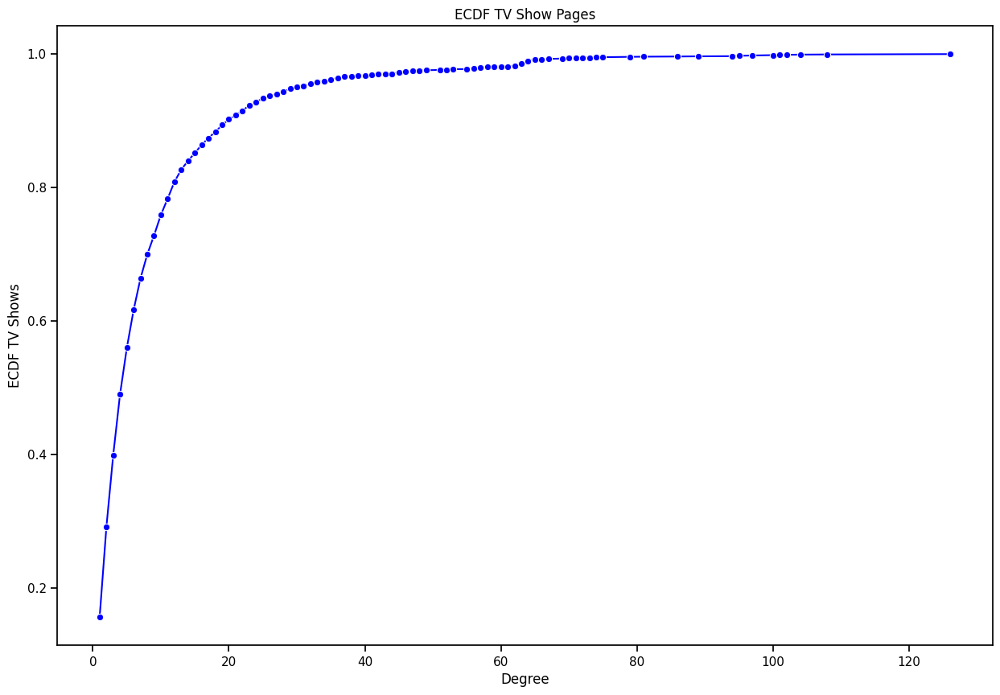

In [36]:
# Get the degree data from your DataFrame
degree = node_degree_df['degree']

# Compute the ECDF
cdf = ECDF(degree)

# Get the unique degree values
x = np.unique(degree)

# Get the ECDF values for these degrees
y = cdf(x)

# Create the plot using Seaborn
plt.figure(figsize=(15, 10))
sns.lineplot(x=x, y=y, color='b', marker='o')

# Set the title and labels
plt.title("ECDF TV Show Pages")
plt.xlabel("Degree")
plt.ylabel("ECDF TV Shows")

# Show the plot
plt.show()

From the plot, we can see that the curve starts to sort of plateau around degree This means that approximately 90% of the TV shows have 20 or fewer mutual likes with other pages. On that other hand, if we look at a degree of around of 60, the ECDF value is close to 1. This means that almost all (or 100%) of the TV show pages have 60 or fewer mutual likes, suggesting that these could be the 'hubs' or popular TV show pages in the network.

We can observe how the degrees are distributed and identify pattern such as few TV show pages have a high degree. As the degree increases, the curve become less steep and eventually plateau near ECDF reaching plateau at around 1. Indicating that there are fewer TV show pages are not widely connected. 

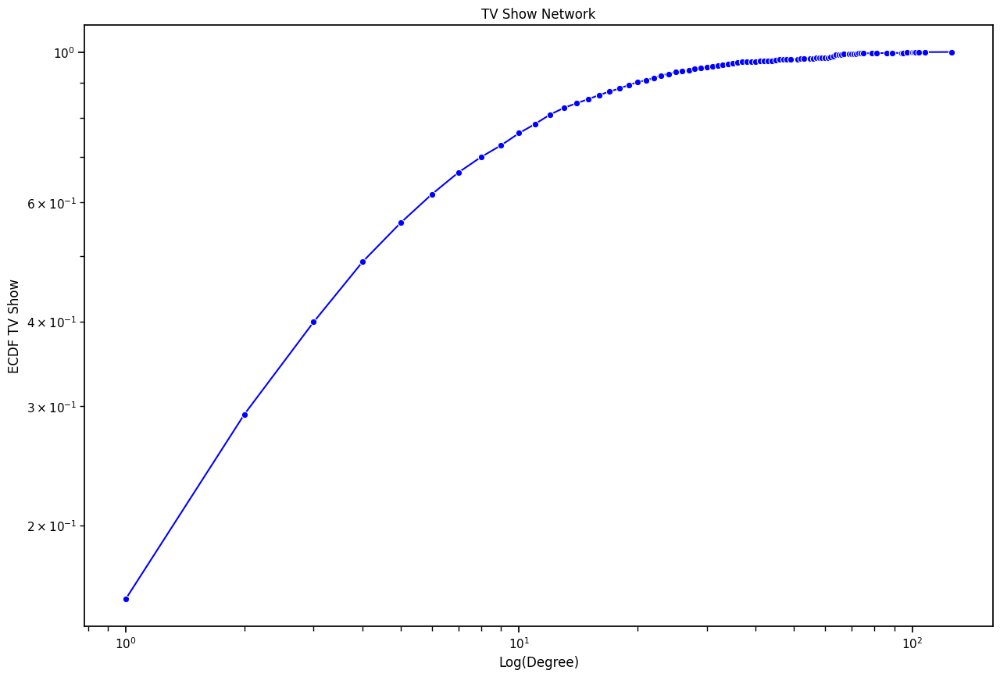

In [37]:
# Get the degree data from your DataFrame
degree = node_degree_df['degree']

# Compute the ECDF
cdf = ECDF(degree)

# Get the unique degree values
x = np.unique(degree)

# Get the ECDF values for these degrees
y = cdf(x)


# Create the plot using Seaborn
plt.figure(figsize=(15, 10))
sns.lineplot(x=x, y=y, color='b', marker='o')

# Set the scale of x and y axes to logarithmic
plt.xscale('log')
plt.yscale('log')

# Set the title and labels
plt.title("TV Show Network")
plt.xlabel("Log(Degree)")
plt.ylabel("ECDF TV Show")


# Show the plot
plt.show()

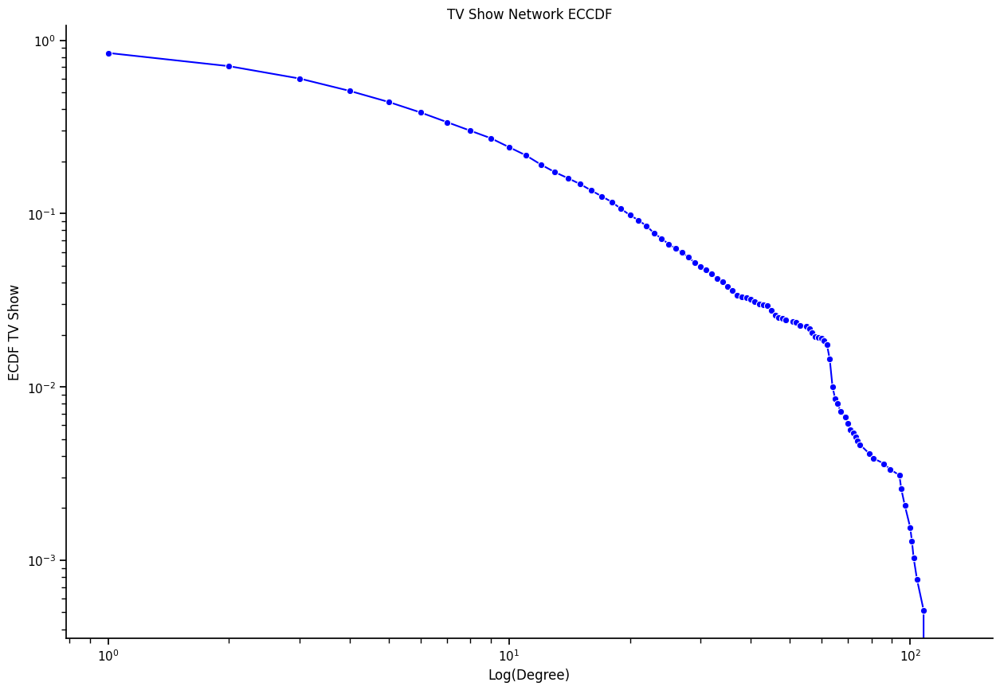

In [82]:
# Get the degree data from your DataFrame
degree = node_degree_df['degree']

# Compute the ECDF
cdf = ECDF(degree)

# Get the unique degree values
x = np.unique(degree)

# Get the ECDF values for these degrees
y = cdf(x)


# Create the plot using Seaborn
plt.figure(figsize=(15, 10))
sns.lineplot(x=x, y= 1- y, color='b', marker='o')

# Set the scale of x and y axes to logarithmic
plt.xscale('log')
plt.yscale('log')
# Remove the top and right axes
sns.despine()

# Set the title and labels
plt.title("TV Show Network ECCDF")
plt.xlabel("Log(Degree)")
plt.ylabel("ECDF TV Show")


# Show the plot
plt.show()

The interpretation is the same as the prvious plot with most of the TV show pages having a low degree and a steep decline of the curves at the begining indicating a large proportion of TV show pages having a low degree. If we look at the curve we can see that it drops steeply at around degree 100 that we see that only a small proportion approximately 20% of the TV show pages have more than 100 mutual likes with other pages. If we look at degree of 10, the ECCDF value is close to 0. This means that a majority of the TV show pages have fewer than 10 mutual likes. 

### Random Graph vs TV Show Graph

We would use null models (random networks) as fundamental tool in network analysis, allow us to understand whether the observed properties of a network are due to some specific underlying mechanism or are simply the result of chance. By comparing the observed network with a null model, we can determine which features of the network are significant. So in order to do this we build an Erdos-Reyni random graph using the probability and use the number of nodes from our observed graph.

In [38]:
# Setting the probability (p) equal to the density of observed graph
p = density
# Build your random graph
random_graph = nx.fast_gnp_random_graph(G.order(), p)

Let us see the number of links our random of graphs has and compare it with the links of our observed graph. We expect for the numbers to be close to each other 

In [39]:
# Check the Number of Links of the Random Graph and Compare it to the TV Show links 
print('Number of nodes: {}'.format(random_graph.order()))
print('Number of links of random graph: {}'.format(random_graph.size()))
print(f"Number of links for observed graph: {G.number_of_edges()}")

Number of nodes: 3892
Number of links of random graph: 17179
Number of links for observed graph: 17239


The we will be computing the number 

In [40]:
# Compute the degree values of the random network
random_degree_values = list(dict(random_graph.degree()).values())
# Print the statistics
print("Random Network Standard Deviation:", np.std(random_degree_values))
print("Random Network Mean:", np.mean(random_degree_values))
print("Random Network Median:", np.median(random_degree_values))
print("Random Network Min:", np.min(random_degree_values))
print("Random Network Max:", np.max(random_degree_values))


Random Network Standard Deviation: 2.9666985555175573
Random Network Mean: 8.827852004110998
Random Network Median: 9.0
Random Network Min: 0
Random Network Max: 25


The mean degree is approximately 8.78 and the median is 9 suggesting that on average a page in the random network has about 9 mutual likes with other pages. The standard deviation is approximately 2.96, which indicates that the degree of the pagesin the random network are relatively close to the mean. 

In [41]:
# Compute the degree values of the observed network
observed_degree_values = list(dict(G.degree()).values())
# Print the statistics
print("Observed Network Standard Deviation:", np.std(observed_degree_values))
print("Observed Network Mean:", np.mean(observed_degree_values))
print("Observed Network Median:", np.median(observed_degree_values))
print("Observed Network Minimum Degree:", np.min(observed_degree_values))
print("Observed Network Maximum Degree:", np.max(observed_degree_values))


Observed Network Standard Deviation: 12.557619271333127
Observed Network Mean: 8.85868448098664
Observed Network Median: 5.0
Observed Network Minimum Degree: 1
Observed Network Maximum Degree: 126


The mean degree is approximately 8.86, and the median is 5. This suggest that, on average, a page in the observed network has about 5 to 9 mutual likes with other pages. The standard deviation is approximately 12.56, which is much larger than that of the random network. This indicates that the degree of the pages in the observed network are more spread out from the mean. The minimum degree is 1 and the maximum is 126, showing that the degree in the observed network range 1 to 126. 

Comparing these results, we can see that the observed network has a wider range of degrees and a higher standard deviation than the random network. This suggests that the observed network has a more heterogenous degree distrubtion, with a small number of 'hub' pages having many mutual likes and larfe number of pages having few mutual likes. 

Now in order to visualise the stark differences we will plot the ECCDF for the random graph and our TV Show network in order to gain insight into the structure of the network. We will be plotting the observed network in the same color we have used in the previous section — blue and we will plotting the random network ECCDF in a red line. If the blue line is significantly different fron the red line it suggests that the degree distribution of teh TV show network is not random but is influenced by some underlying factors. 

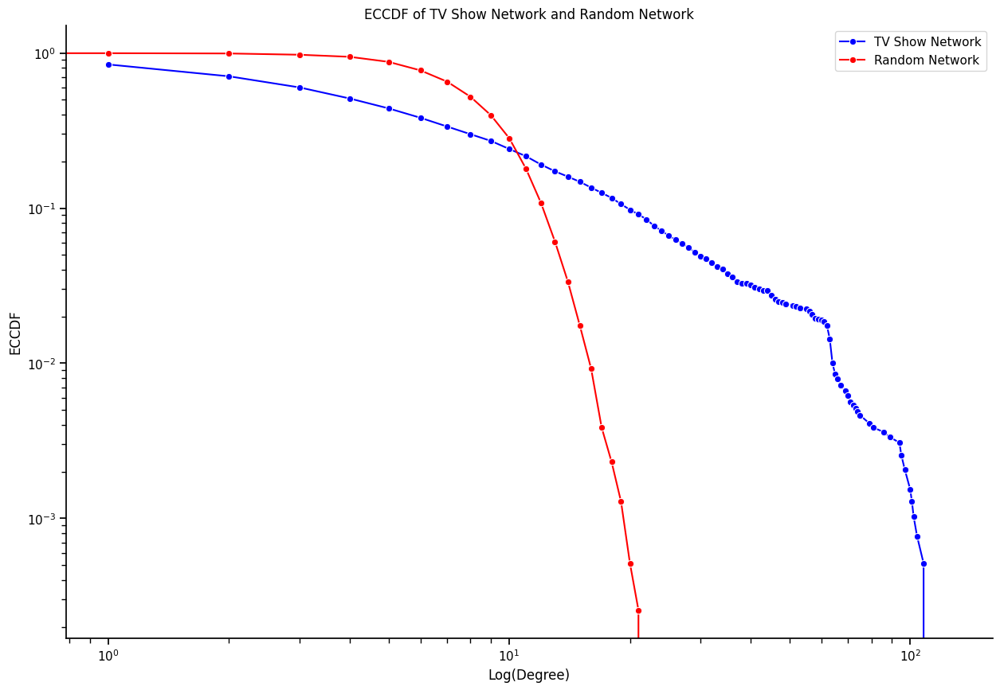

In [42]:
# Get the degree data from your DataFrame
degree = list(dict(G.degree()).values())
random_degree = list(dict(random_graph.degree()).values())

# Compute the ECDF
cdf = ECDF(degree)
cdf_random = ECDF(random_degree)

# Get the unique degree values
x = np.unique(degree)
x_random = np.unique(random_degree)

# Get the ECDF values for these degrees
y = cdf(x)
y_random = cdf_random(x_random)

# Create the plot using Seaborn
plt.figure(figsize=(15, 10))

# Plot the observed network
sns.lineplot(x=x, y=1-y, color='b', marker='o', label='TV Show Network')

# Plot the random network
sns.lineplot(x=x_random, y=1-y_random, color='r', marker='o', label='Random Network')

# Set the scale of x and y axes to logarithmic
plt.xscale('log')
plt.yscale('log')

# Set the title and labels
plt.title("ECCDF of TV Show Network and Random Network")
plt.xlabel("Log(Degree)")
plt.ylabel("ECCDF")
# Remove the top and right axes
sns.despine()

# Show the legend
plt.legend()


# Show the plot
plt.show()

Based on the result we can see that blue line decreases more slowly than the random ECCDF suggesting again that there are more hubs in the TV show network. Now let us take it one step further and examine the hubs within the dataset. We can see tfrom the plot that the red line reaches near zero at a little above 10 degree. This shows us that almost all of the TV show pages in the random network have fewer than 10 mutual likes. As oppose to the TV show network that starts to drop around a degree of a little above 100 degree. 

# Node Level Analysis 

### Degree Centrality 

But now we will formally introduce what the degree centrality of a node which is the edges that is connected to a node. We will be assessing the top nodes that have the largest number of connection as the most central node in the network. We will using a count systems for each node's number of a edges. It can help us identify the TV shows that are the most mutually liked, indicating popularity accross diverse categories. 

In [43]:
deg_centr = nx.degree_centrality(G)
sort_orders = sorted(deg_centr.items(), key=lambda x: x[1], reverse=True)

print("10 most important nodes for Degree Centrality:")
print('-'* 50)
print('\n'.join(f'{node}: {centrality}' for node, centrality in sort_orders[:10]))


10 most important nodes for Degree Centrality:
--------------------------------------------------
Home & Family: 0.03238242097147263
Queen of the South: 0.03238242097147263
So You Think You Can Dance: 0.027756360832690827
Glee: 0.026728347468517093
New Girl: 0.026214340786430226
Family Guy: 0.02595733744538679
The Simpsons: 0.02570033410434336
Dancing with the Stars: 0.02570033410434336
MasterChef: 0.024929324081213056
Bones: 0.024929324081213056


A high degree centrality score for our network could indicate that a page with high degree centrality might be a very popular show that is liked by the audiences of many other shows. It sort of has a broad appeal that spans tha audiences of many other shows. May be it could feature a popular actor, belong to great genre or have a great story line. It would also that since we have a high degree centrality that any changes or updates could potentially reach and have a large impact number of the other pages. 

We can see from the result that 'Home & Family' and 'Queen of the South' have the highest degree centrality. These two TV pages have the highest memember of mutual likes with other pages in the network. Then we can see that "So You Think You Can Dance", "Glee" and "New Girl" have also a higher degree centrality when compared to the rest. Overall we can see that TV show pages that are most important nodes in our network in terms of degree of centrality. 

It is important to note that the degree centrality seems quite low, the top 10 nodes with the highest degree have few TV shows that they are mutually likes with. Even though the reason is not clear it could be to the different types of contents and preferences of audiences. 

### Closeness Centrality 

Closeness centrality is another measure that allows us to evaluate by assessing the most influential and central node that can reach other nodes quickly. It measures the nodes smallest average path length for the nodes that are linked to other nodes. It is important because it takes into account not only the immediate connection of a node but also the indirect ties of all other nodes in the network. Again in our case it could represent the popularity, broad appeal and influence of the TV Show. 

In [68]:
closeness_centrality = nx.closeness_centrality(G)
sort_orders_closeness_centrality = sorted(closeness_centrality.items(), key=lambda x: x[1], reverse=True)

print("10 most important nodes for Closeness Centrality:")
print('-'* 50)
print('\n'.join(f'{node}: {centrality}' for node, centrality in sort_orders_closeness_centrality[:10]))


10 most important nodes for Closeness Centrality:
--------------------------------------------------
Queen of the South: 0.2609832986786505
Home & Family: 0.2593827078194787
Access: 0.25618909665525413
The Tonight Show Starring Jimmy Fallon: 0.251860961874555
The Voice: 0.2477712684666327
The List: 0.24425612052730697
America's Got Talent: 0.24422545819733868
The Insider: 0.24265668849391955
The Biggest Loser: 0.24197761194029851
Parenthood: 0.2401407146824662


"Queen of South" has the highest closeness centrality. This means that the TV show page is, on average, close to all other pages in the network in term of mutual likes. This could suggest that "Queen of South" has a broad appeal that spans the audiences of many other shows. Similarly, "Home & Family" and "Access" also have high closeness centrality, indicating that these TV show pages as the top ones. 

What is interesting is that a majority of the top 10 shows are contest shows. This indicates that contest shows have a wide appeal and are mutually liked by a diverse range of other TV show pages. 

### Betweeness Centrality

Betweeness centrality is a measure of a node's centrality in a network, which is equal to the number of shortest paths from all vertices to all others that pass through that node. In this context a TV show page with high betweeness centrality is one that appears on many shortest paths between other TV show pages in terms of mutual likes. 

In [72]:
betweeness_centrality = nx.betweenness_centrality(G)
sort_orders_betweeness_centrality = sorted(betweeness_centrality.items(), key=lambda x: x[1], reverse=True)

print("10 most important nodes for Betweeness Centrality:")
print('-'* 50)
print('\n'.join(f'{node}: {centrality}' for node, centrality in sort_orders_betweeness_centrality[:10]))


10 most important nodes for Betweeness Centrality:
--------------------------------------------------
Queen of the South: 0.10544488181477078
Home & Family: 0.09352541687013526
The Tonight Show Starring Jimmy Fallon: 0.0804900367587108
The Voice Global: 0.07471499425323286
The Voice: 0.07465790776474893
Access: 0.06910198604847143
American Idol: 0.04056916590873054
Downton Abbey: 0.03896683285298819
The List: 0.03791231873809947
tagesschau: 0.0342480735374294


"Queen of South" has the highest betweeness centrality and this means that this TV show pages lies on paths between other pages. "Home & Family" and the "Tonight Show Starring Jimmy Fallon" lies on high number of shortests paths between other pages in the network. "Queen of South" acts as a bridge between many other TV show pages in the network of mutual likes. 

### Eigenvector Centrality 

Eigenvector centrality is proportional to the sum of centrality scores of the neighborhood. It assigns a relative scores to all nodes in the network based on the principle that connections to high-scoring nodes contribute more to the score of the node in question than equal connection to low-scoring nodes. When considering the eigenvector centrality we are considering popular TV Shows, that can influenctials shows or trend-setters.

In [116]:
eig_centr = nx.eigenvector_centrality(G)
sort_orders = sorted(eig_centr.items(), key=lambda x: x[1], reverse=True)

print("10 most important nodes for Eigenvector Centrality:")
print('-'* 50)
print('\n'.join(f'{node}: {centrality}' for node, centrality in sort_orders[:10]))

10 most important nodes for Eigenvector Centrality:
--------------------------------------------------
So You Think You Can Dance: 0.1385223216549383
New Girl: 0.13848281762604034
Bones: 0.13726421325173369
MasterChef: 0.136903014216721
Family Guy: 0.1368299898563672
Bob's Burgers: 0.13667617355347736
The Simpsons: 0.13647646727246324
Brooklyn Nine-Nine: 0.13641567503577712
Glee: 0.13617885533978646
Hell's Kitchen: 0.1358752564911995


Our results indicate that shows like "So You Think You Can Dance" and "New Girl" have high eigenvector centrality. "New Girl" and "Bones" also have eigenvector centrality, indicating that these TV show pages are also influential in the network. The rest of the TV have a high eigenvector centrality although not as high as the top ones. And we can see that the results for the eigenvector centrality are very different than the degree centrality and the eigenvector centrality.

### Page Rank 

PageRank algorithm is the basis of the page ranking techniques within the Google search engine. PageRank is a measure of the importance of nodes in a network, it was originally designed by Google's founders to measure the importance of webpages. It basically a fraction of the source's nodes centrality, it divides the centrality with the outlinks. 

In [73]:
page_rank = nx.pagerank(G)
sort_orders_page_rank = sorted(page_rank.items(), key=lambda x: x[1], reverse=True)

print("10 most important nodes for Page Rank:")
print('-'* 50)
print('\n'.join(f'{node}: {centrality}' for node, centrality in sort_orders_page_rank[:10]))

10 most important nodes for Page Rank:
--------------------------------------------------
Home & Family: 0.0030710596650573327
Queen of the South: 0.0030511446198516613
The Voice Global: 0.00274125255873141
tagesschau: 0.0016414592756192443
24 Oras: 0.0016208329501523522
Les séries Canal+: 0.0015834528704524377
Access: 0.001428279270622895
CNN en Marcha: 0.0014191922405776675
The Tonight Show Starring Jimmy Fallon: 0.0014069977690315452
Good Morning America: 0.0013733041532778708


We can see that the "Home & Family" has the highest PageRank meaning that this TV show page is linked to by many other pages that are important or popular. This means that this is a highly important TV show page in the network of mutual likes. "Queen of South" and "The Voise Global" have a high PageRank indicating these TV show pages aare also important in the network. We can see from the fact that the result is low it could be an indication that we have a diverse range of interest the audiences of these TV shows becuase mutual likes are spread out accross many different pages, rather than being concentrated on few key pages. 

### Hubs 

In our scale-free network it was evident that some TV shows are hubs. Hubs are nodes with a high degree of connection and in our case we will be focusing on the networks above the 99th percentiles. Then we will see how many nodes are hubs and which shows are actually hubs. These are the show pages that have the most mutual likes with other pages, indicating they are popular or influential within your network. 

In [81]:
# We calculate the degree of each node and store it in a dictionary
hub_node = [k for k,v in dict(G.degree()).items() if v>= percentile_99]
# Then we want to know the exact numbers of hubs within the network
print("The Total Number of Hubs in Our TV Show Network:", len(hub_node))
# Print the names of the TV shows that are considered hubs 
print("The TV Shows that are Hubs:" )
print('\n'.join(f'{node}' for node in hub_node))


The Total Number of Hubs in Our TV Show Network: 39
The TV Shows that are Hubs:
American Grit
Wayward Pines
MasterChef
The Grinder
FOX Teen Choice Awards
Rosewood
Scream Queens
New Girl
Gotham
Family Guy
Grandfathered
Empire
Second Chance
So You Think You Can Dance
The Simpsons
Glee
MasterChef Junior
Bones
Sleepy Hollow
Lucifer
Hell's Kitchen
24: Legacy
Brooklyn Nine-Nine
Hotel Hell
The Last Man on Earth
Bob's Burgers
The Bachelorette
Castle
Dancing with the Stars
The Middle
Modern Family
The View
Once Upon a Time
Revenge
Suburgatory
Rookie Blue
Home & Family
Queen of the South
tagesschau


As we can see we have identified 39 TV shows that have a high number of mutual likes with other shows. These are likely to be popular or influential shows and are broadly liked by the users. We can see that shows like "American Grit", "Wayward Pine" and "Master Chef" are actuallu identified as hubs with our network. Also we can see that some of the prominent shows with high centrality measured in various ways alos appear, such as "Home & Family", "Queen of the South", "So You Think You Can Dance", "New Girl" and "Bones" just to name a few. 

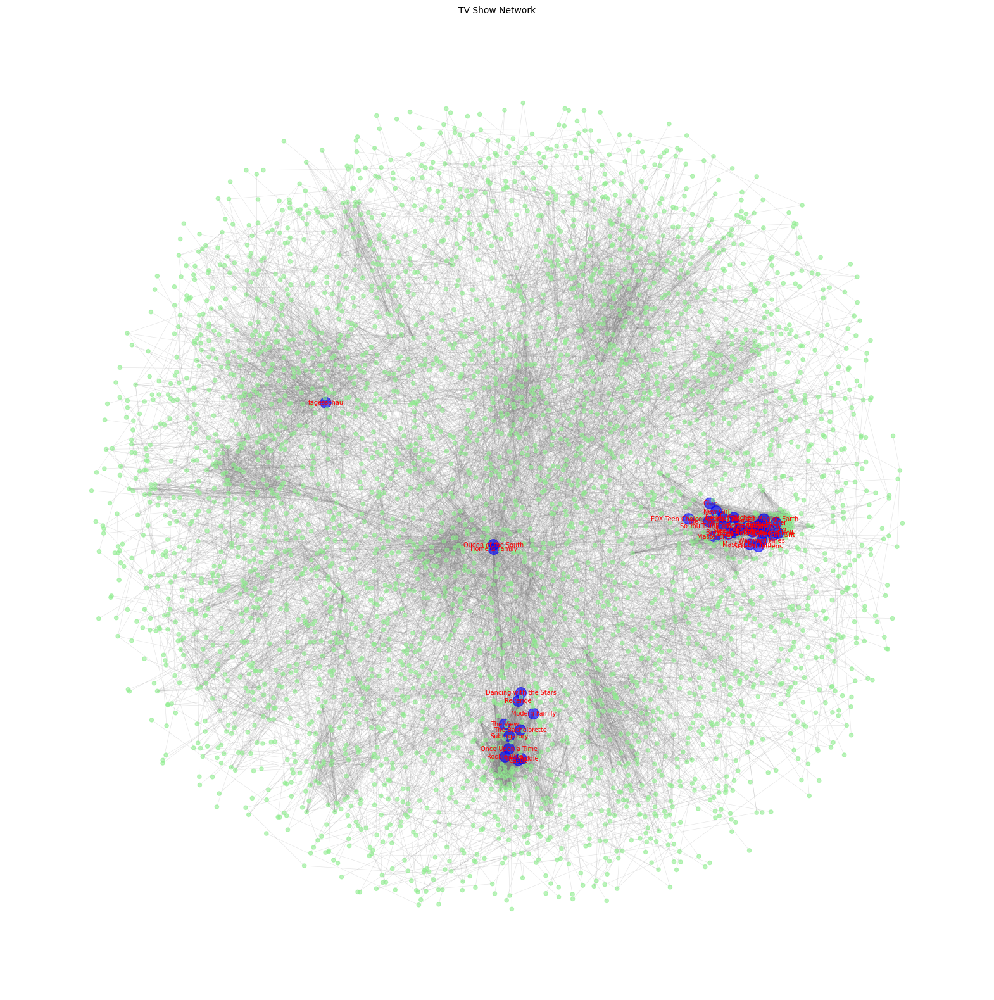

In [132]:
# draw the graph
pos = nx.spring_layout(G, k = 0.15)

# color the nodes according to their partition
color_map = []
size_map = []
node_index = {}

for node in G.nodes():
    if node not in hub_node:
        color_map.append('lightgreen')  # non-hub nodes in light green
        size_map.append(20)  # smaller size for non-hub nodes
    else:
        color_map.append('blue')  # hub nodes in dark blue
        size_map.append(150)  # larger size for hub nodes
        node_index[node] = node

plt.figure(figsize=(20,20))  # increase figure size for better visibility

# draw nodes with specified colors and sizes
nx.draw_networkx_nodes(G, pos, node_size=size_map, node_color=color_map, alpha=0.6)

# draw edges with a lighter color and smaller width
nx.draw_networkx_edges(G, pos, alpha=0.2, width=0.5, edge_color='grey')

# draw labels for hub nodes in white for contrast
nx.draw_networkx_labels(G, labels=node_index, pos=pos, font_size=7, font_color='r')

plt.title('TV Show Network Hubs', fontsize=10)  # add a title to the graph
plt.axis('off')  # remove axis for a cleaner look

plt.show()


### Conclusion for Node-Level Analysis 

Overall our analysis indicates that TV show network reveals a few key shows are central to the network in terms of various centality. When analysing our degree centrality, closeness centrality, betweeness centality and page rank we find the "Home & Family" and "Queen of South" to have a high centrality. When inspecting the eigenvector centality we can see that we have a different result with "So You Think You Can Dance", "New Girl" and "Bones" having the highest eigenvect centrality. 

It is important to note that while the degree centrality, the betweeness centrality and the closeness centrality give similar measure for some nodes in a network they each provide a unique perspective on the node's role and position in the network. The eigenvector centrality is different than the rest because of that it a node is important of it is conncected to other important nodes taking into account the centrality of the other mutually liked pages.  

# Group-Level Analysis 

### Clique

We will start by analysing the clique of our network. In social network a clique enables us to analyse mutual friendships. A clique in a graph network is a subset of vertices such that every node is connected to every other node. When measuring the size of clique we are basically analysing the number of vertices it contains. 

When we tie it to our Facebook Pages of our TV shows a clique would represent a group of TV shows where each show is mutually liked along with all the other shows in the group. This would potentially enable us to identify closely related TV shows based on mutual likes. 

In [112]:
# Extract all of the cliques in our network 
cliques = list(nx.find_cliques(G))

# Print all cliques
for clique in cliques:
    print(clique)

['Superkids', "Germany's next Topmodel", 'taff', 'red.tv']
['Superkids', 'Got To Dance Germany']
['Superkids', 'SAT.1 Show']
['Superkids', 'Circus HalliGalli']
['The Good Wife', 'Criminal Minds', '2 Broke Girls', 'Person of Interest', 'Mike & Molly', 'Blue Bloods', 'Hawaii Five-0', 'NCIS', 'Survivor']
['The Good Wife', 'Criminal Minds', '2 Broke Girls', 'Person of Interest', 'Mike & Molly', 'Blue Bloods', "Let's Make A Deal"]
['Red Widow', 'Extreme Weight Loss']
['Red Widow', 'Project Runway', "Abby's Studio Rescue", 'Witches of East End']
['Red Widow', 'Project Runway', "Abby's Studio Rescue", 'Official Army Wives', 'Drop Dead Diva']
['Red Widow', 'Project Runway', 'The Client List', 'Official Army Wives', 'Drop Dead Diva']
['Red Widow', 'KSPR News']
['Red Widow', 'Bring It']
['Red Widow', 'Dance Mums with Jennifer Ellison']
['Guy Code', 'MTV’s Joking Off']
['Guy Code', 'Awkward']
['Guy Code', 'Off The Bat From The MLB Fan Cave']
['Guy Code', "Ain't That America With Lil Duval"]
['Guy

In [113]:
# We want to know the length of our list of cliques
n_cliques = len(cliques)
print("Total number of cliques:", n_cliques)

Total number of cliques: 6355


Each of the cliques are TV shows where each show is mutually liked by all other shows in the same group. This indicates that useres share a common interest in these shows, may be because of similar themes same genre, or airing schedule. And based on the number of total number of cliques we can see that it is a high value indicating use base with distinct preferences. Now let us take a look at some stats based on the cliques that we have found within our network. So based on the number of cliques we can see that there is precense of audiences that are divided into many differnet communities based on their preferences for different types of TV shows. 

In [114]:
# Count the number of shows within eahc clique
sizes_of_cliques = [len(x) for x in cliques]
# Extract the maximum number of shows that is found within a cliqe
maximum_clique_size = max(sizes_of_cliques)
print("Maximum Clique Size:", maximum_clique_size)
average_clique_size = sum(sizes_of_cliques)/n_cliques
print("Average Clique Size:", average_clique_size)
minimum_clique_size = min(sizes_of_cliques)
print("Minimum Clique size", minimum_clique_size)

Maximum Clique Size: 57
Average Clique Size: 4.42690794649882
Minimum Clique size 2


Based on this simple stat that looks further at the number of TV shows that is conatined within the cliques, we can see that the largest group of TV shows, where each shows is mutually liked by all other shows in the group consists of 57 shows. This may susggest that a strong commonality or shared interest among the users who like 57 shows. Or it could also be due to a popular genre, or similar theme, which we will briefly inspect. 

The average clique size indicates that a group of mutually liked TV consist about 4 to 5 shows, indicating that users might actually like a handful shows. Where as the minimum clique size is as expected 2 meaning there are at least some TV shows that are mutually like with one other show and could be niche shows with specfic user base. 

Now let us find the cliques that satisfy the maximum clique condition which are 57 shows that are mutual liked in one clique. 

In [115]:
maximum_cliques = [x for x in cliques if len(x) == maximum_clique_size]
print("Total number of shows with maximum clique:", len(maximum_cliques))


Total number of shows with maximum clique: 5


We can see that there are 5 number of cliques that contain the 57 number of shows. This means there are 5 different variations of 57 different mutually likes shows. But we can conduct further anlysis and try to see what are the common shows that appear in the 5 different variation with 57 mutually liked shows. We basically want to know which TV shows pages are present in all of the largest fully interconnected groups(cliques) within the network of mutually likes Facebook TV show pages.

In [134]:
# We convert each clique in maximum_cliques into a set to perform set operations
maxmimum_clique_set = [set(x) for x in maximum_cliques]
# Find the intersection of all the sets in maximum_clique sets
shows_in_all_maximum_cliques = list(reduce(lambda x, y: x.intersection(y), maxmimum_clique_set))
print("Number of TV shows present in all maximum cliques:",len(shows_in_all_maximum_cliques))
print('\n'.join(f'{node}' for node in shows_in_all_maximum_cliques))


Number of TV shows present in all maximum cliques: 56
Son of Zorn
The Last Man on Earth
Gotham
Scream Queens
MasterChef
Superhuman
Hell's Kitchen
You The Jury
Home Free FOX
Shots Fired
The F Word
The Exorcist FOX
Showtime At The Apollo
The Simpsons
Bob's Burgers
The Grinder
The Gifted
Houdini & Doyle
MasterChef Junior
24: Legacy
The Resident
Bones
Sleepy Hollow
Kicking & Screaming
APB FOX
Famous
LA to Vegas
Rosewood
Ghosted
Hotel Hell
Cooper Barrett's Guide to Surviving Life
Family Guy
Brooklyn Nine-Nine
Lucifer
New Year's Eve on FOX
Prison Break
Wayward Pines
So You Think You Can Dance
Pitch
Love Connection FOX
Grandfathered
STAR
Bordertown
American Grit
Making History
The Orville
Glee
New Girl
Party Over Here
My Kitchen Rules1
The Mick
FOX Teen Choice Awards
Empire
Second Chance
Coupled
Beat Shazam


From the result we can see that 56 TV shows are present in all of the largest cliques. Let us visualise these 56 shows within the entire network. 

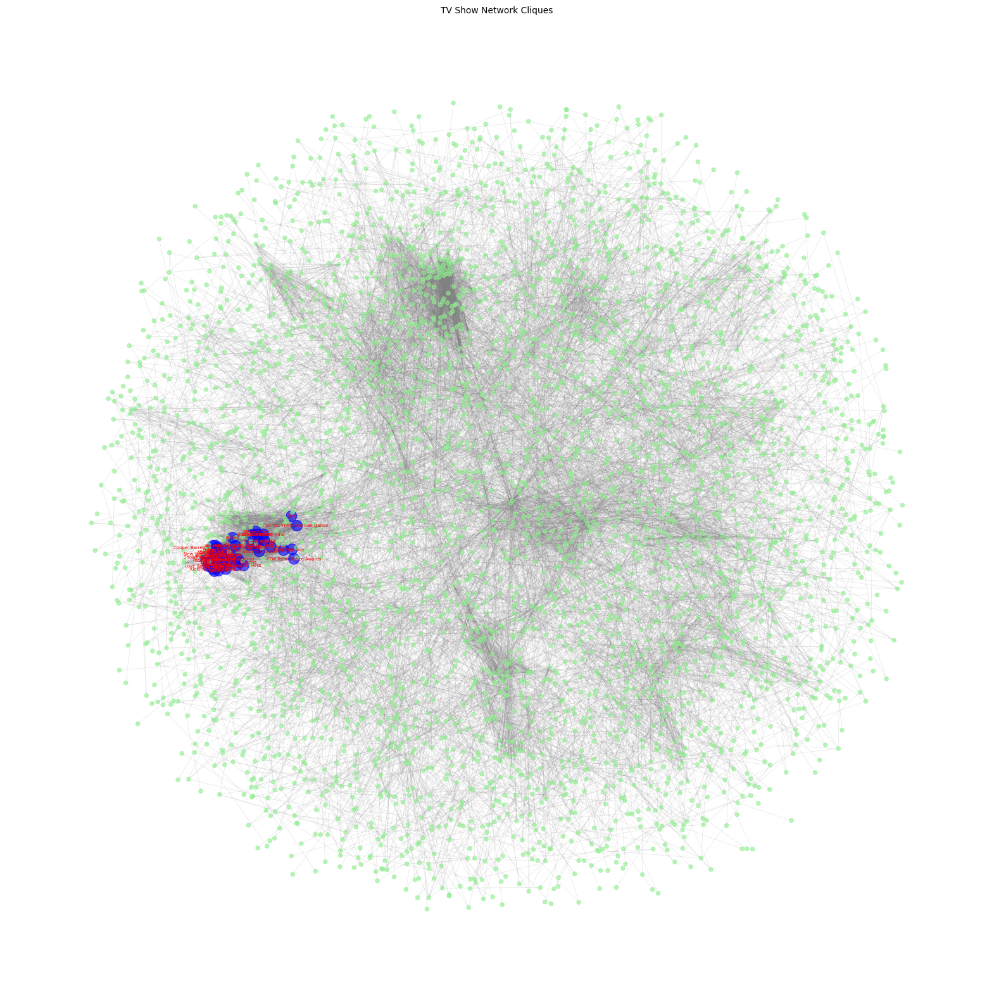

In [167]:
# draw the graph
pos = nx.spring_layout(G, k = 0.15)

# color the nodes according to their partition
color_map = []
size_map = []
node_index = {}

for node in G.nodes():
    if node not in shows_in_all_maximum_cliques:
        color_map.append('lightgreen')  # non-clique nodes in light green
        size_map.append(20)  # smaller size for non-clique nodes
    else:
        color_map.append('blue')  # clique nodes in dark blue
        size_map.append(150)  # larger size for clique nodes
        node_index[node] = node

plt.figure(figsize=(20,20))  # increase figure size for better visibility

# draw nodes with specified colors and sizes
nx.draw_networkx_nodes(G, pos, node_size=size_map, node_color=color_map, alpha=0.6)

# draw edges with a lighter color and smaller width
nx.draw_networkx_edges(G, pos, alpha=0.2, width=0.5, edge_color='grey')

# draw labels for clique nodes in white for contrast
nx.draw_networkx_labels(G, labels=node_index, pos=pos, font_size=5, font_color='r')

plt.title('TV Show Network Cliques' , fontsize=10)  # add a title to the graph
plt.axis('off')  # remove axis for a cleaner look

plt.show()


### Triangles 

A triad is a subgraph with three nodes, and we are usually interested whether they are closed or open to form a triangle. A complete triad is a clique of size three. We are interested in knowing the number of closed triangles that a node is involved in. 

In [168]:
# Compute the number of triangles for each node
triangle_counts = nx.triangles(G)

# Sort the nodes by their triangle count in descending order
sorted_nodes_by_triangles = sorted(triangle_counts.items(), key=lambda x: x[1], reverse=True)

# Get the top nodes
top_nodes_by_triangles = sorted_nodes_by_triangles[:20]

print("Total number of triangles in the graph: ", sum(list(nx.triangles(G).values())))

print("Trinangle Count For TV Shows")
# Print the top nodes and their triangle counts
for node, count in top_nodes_by_triangles:
    print(f"{node} : {count}")

Total number of triangles in the graph:  261270
Trinangle Count For TV Shows
New Girl : 2584
So You Think You Can Dance : 2579
Bones : 2555
Bob's Burgers : 2517
Family Guy : 2511
The Simpsons : 2502
MasterChef : 2501
Brooklyn Nine-Nine : 2493
Glee : 2480
Hell's Kitchen : 2462
Sleepy Hollow : 2380
Wayward Pines : 2236
24: Legacy : 2036
MasterChef Junior : 2018
Gotham : 2004
Empire : 1995
Rosewood : 1985
The Last Man on Earth : 1967
Hotel Hell : 1957
American Grit : 1956


We can see that the total number of triangles within the graph is 261,255. 
Based on the result "New Girl" is involved in 2584 triangles instances where two other TV shows that mutually like "New Girl" also mutually like each other. When we inspect out top 20, we can see that "American Grit" has smaller number of triangles when compaerd to "New Girl". 

### Clustering Coefficient

Clustering coefficient is the fraction of node's neighbors that are also neighbors with each other. Neighbors are the set of nodes connected to it by an edge, not including the node itself. We can compute the gloabl clustering coefficient of the entire network and we can also compute the local clustering coefficent of nodes for ego networks. We will start our analysis by computing the global and average clustering coefficient of a network. 

In terms of global clustering coefficent we are calculating the number of closed triplets over the total number of triplets. Basically we are inspecting the transitivity where we would calculate the number of triplets that are closed over the total number of triplets that are both open and closed. With respect to local clustering coefficient we quantify how connected the neighborhood of nodes are. In order to compute the average clustering coefficent we use the local clustering coefficent of all the nodes in the graph. 

In [137]:
# Compute the global clustering coefficient of the network
global_clustering_coefficient = nx.transitivity(G)
print("Global Clustering Coefficient:", global_clustering_coefficient)

# Compute the average clustering coefficient of the network
average_clustering_coefficient = nx.average_clustering(G)
print("Average Clustering Coefficient:", average_clustering_coefficient)

Global Clustering Coefficient: 0.5906435656994041
Average Clustering Coefficient: 0.3737384324597403


Global clustering coefficient suggest that about 59% of the connected triples of TV shows are cliques, this means that if we have two TV shows that are mutually liked then we have a 59% chhance that they also mutually like each other. This is indicative that there is a relatively high tendency for TV shows to become tight-knight groups based on the mutual likes which are reciprocated among them. 

On the other hand we can see that we have an average clustering coefficient of 0.37, which means that around 37% of the possible connection between the shows that are mutually liked. This means that if we pick a node randomly, and inspect the neighbors of that node we would find on average about 37% of connection between shows that are mutually liked. This indicates a moderate level of connection among neighbors of TV shows. 

Now in the next stage we will look at the local clustering and pick the top 10 nodes that have the highest local clustering coefficent. 

In [147]:
# Compute the local clustering coefficient for each node
local_clustering_coefficients = nx.clustering(G)

# Sort the nodes by their local clustering coefficient in descending order
sorted_nodes = sorted(local_clustering_coefficients.items(), key=lambda x: x[1], reverse=True)

# Get the top 10 nodes
top_10_nodes = sorted_nodes[:10]

# Print the top 10 nodes and their local clustering coefficients
for node, coefficient in top_10_nodes:
    print(f"Node: {node}, Local Clustering Coefficient: {coefficient}")

Node: Living Biblically, Local Clustering Coefficient: 1.0
Node: BOOM, Local Clustering Coefficient: 1.0
Node: Jorge Ramos y su Banda, Local Clustering Coefficient: 1.0
Node: Return To Amish, Local Clustering Coefficient: 1.0
Node: The Voice Kids1, Local Clustering Coefficient: 1.0
Node: WEEDIQUETTE, Local Clustering Coefficient: 1.0
Node: Upscale with Prentice Penny, Local Clustering Coefficient: 1.0
Node: Philip K. Dick's Electric Dreams, Local Clustering Coefficient: 1.0
Node: The State, Local Clustering Coefficient: 1.0
Node: Silvana sin Lana, Local Clustering Coefficient: 1.0


We can see that it would be very difficult to extract any information from this so let us try to get some details on the number of nodes that have a 1 and 0 as local clustering coefficient. 

In [146]:
# Count the number of nodes with clustering coefficient of 1
count_1 = sum(1 for coeff in local_clustering_coefficients.values() if coeff == 1)
print("Number of nodes with clustering coefficient of 1:", count_1)

# Count the number of nodes with clustering coefficient of 0
count_0 = sum(1 for coeff in local_clustering_coefficients.values() if coeff == 0)
print("Number of nodes with clustering coefficient of 0:", count_0)

Number of nodes with clustering coefficient of 1: 333
Number of nodes with clustering coefficient of 0: 1242


Ther are 333 nodes in which every pair of their neighbors is also mutually liked with each other. These nodes form a complete graph or a clique. On the other hand we can see that we have 1242 shows where their neighbors are not connected at all, meaning they have no mutual like edge that connects them.

We can see that the total number of triangles within the graph is 261,255. 
Based on the result "New Girl" is involved in 2584 triangles instances where two other TV shows that mutually like "New Girl" also mutually like each other. When we inspect out top 20, we can see that "American Grit" has smaller number of triangles when compaerd to "New Girl". 

## Community 

### Greedy Modularity Optimization

Community detection will help us identify the nodes that are densley connected than the rest of the network. These nodes will represent a community, a meaningful structure that may give us a robust global view. 

In [137]:
G = nx.relabel_nodes(G, lambda x: str(x))
list_community_sets_greedy = list(nx_comm.greedy_modularity_communities(G))
print(list_community_sets_greedy[0:20])

[frozenset({'Parks and Recreation', 'Murder in the First', 'Anthony Bourdain: Parts Unknown', 'Family Feud', 'The River', 'American Masters', 'Private Practice', 'Mind Of A Man', 'Malibu Country', 'Hairspray Live', 'Crafty Men', 'The Sopranos', 'Little Big Shots', 'The Gherm Guys', 'The List', 'Sports Jeopardyǃ', 'Girls', 'NYC-ARTS', 'MASTERPIECE | PBS', 'Cooking With Jack', 'Mr. D', 'Extreme Weight Loss', 'Hot Topics', 'Emigratis', 'Splash', 'The Great Canadian Baking Show', 'The Mystery of Matter: Search for the Elements', 'Smash', 'The Breaks', 'The Daily Show', 'HBO Boxing', 'Growing Up Fisher', 'Independent Lens | PBS', 'KING 5 Evening', 'General Hospital', 'Great News', 'KPLC 7 News Sunrise', 'HLN News Now', 'Cardinal', 'Dish Nation', 'Entourage2', 'Betrayal', 'Black Box', 'Weekend Express HLN', "Dragons' Den", 'Celebrity Taste Makers', 'Hollywood Hunter', 'Celebrity Name Game', 'Guilt', 'Falling Skies Deutschland', 'Agents of S.H.I.E.L.D.', 'Chain Reaction', 'WECT News', 'Stewar

The resilys shows use that lists of sets which represent a community of TV shows page based on their mutual likes. We will be using visualisation techniques as to get a sense of the relationships. Let us start by assigning a label to each community. 

In [138]:
# Assign a community label to each node
partition_greedy = {}
for i, comm in enumerate(list_community_sets_greedy):
    for n in comm:
        partition_greedy[n] = i


In [139]:
# Get the list of communities
communities_greedy = list(partition_greedy.values())

# Calculate the number of communities
num_communities_greedy = len(set(communities_greedy))

# Calculate the size of each community
community_sizes_greedy = [communities_greedy.count(i) for i in range(num_communities_greedy)]

# Calculate the maximum, minimum, and average community size
max_size_greedy = max(community_sizes_greedy)
min_size_greedy = min(community_sizes_greedy)
avg_size_greedy = np.mean(community_sizes_greedy)

print(f"Number of communities (greedy): {num_communities_greedy}")
print(f"Maximum community size (greedy): {max_size_greedy}")
print(f"Minimum community size (greedy): {min_size_greedy}")
print(f"Average community size (greedy): {avg_size_greedy}")


Number of communities (greedy): 59
Maximum community size (greedy): 613
Minimum community size (greedy): 3
Average community size (greedy): 65.96610169491525


Based on our result we can see that we have 59 communities with size ranging from 3 to 613 and an average sice of apprximately 66. Let us visualise the different communities within the graph. We will use different colors for the different communities and try to see if we can get a sense of how the communities are densely connected. 

/var/folders/qg/q4wtx92x1kjfrg1x9bk3_v_w0000gn/T/ipykernel_34385/3642112511.py:5: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed two minor releases later. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap(obj)`` instead.
  cmap = cmap = plt.cm.get_cmap('nipy_spectral')


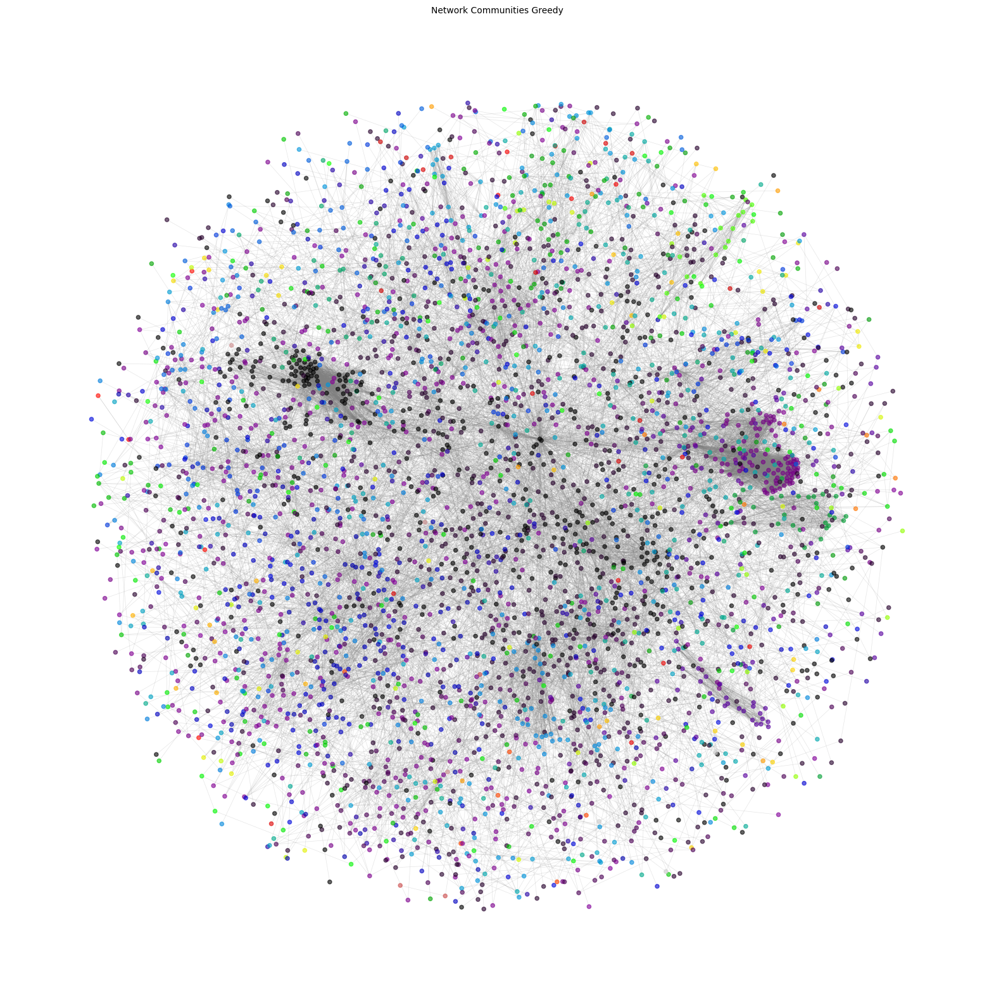

In [140]:
# Create a layout for the nodes
pos = nx.spring_layout(G, k = 0.15)

# Create a color map with a unique color for each community
cmap = cmap = plt.cm.get_cmap('nipy_spectral')


# Set the size for the plot
plt.figure(figsize=(20,20))

# Draw the nodes, coloring them according to their community
node_color = [partition_greedy[node] for node in G.nodes()]
nx.draw_networkx_nodes(G, pos, node_size=20, cmap=cmap, node_color=node_color, alpha=0.6)


# Draw the edges
nx.draw_networkx_edges(G, pos, alpha=0.2, width=0.5, edge_color='grey')

plt.title('Network Communities Greedy', fontsize=10)  # add a title to the graph
plt.axis('off')  # remove axis for a cleaner look

plt.show()


/var/folders/qg/q4wtx92x1kjfrg1x9bk3_v_w0000gn/T/ipykernel_988/3642112511.py:5: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed two minor releases later. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap(obj)`` instead.
  cmap = cmap = plt.cm.get_cmap('nipy_spectral')


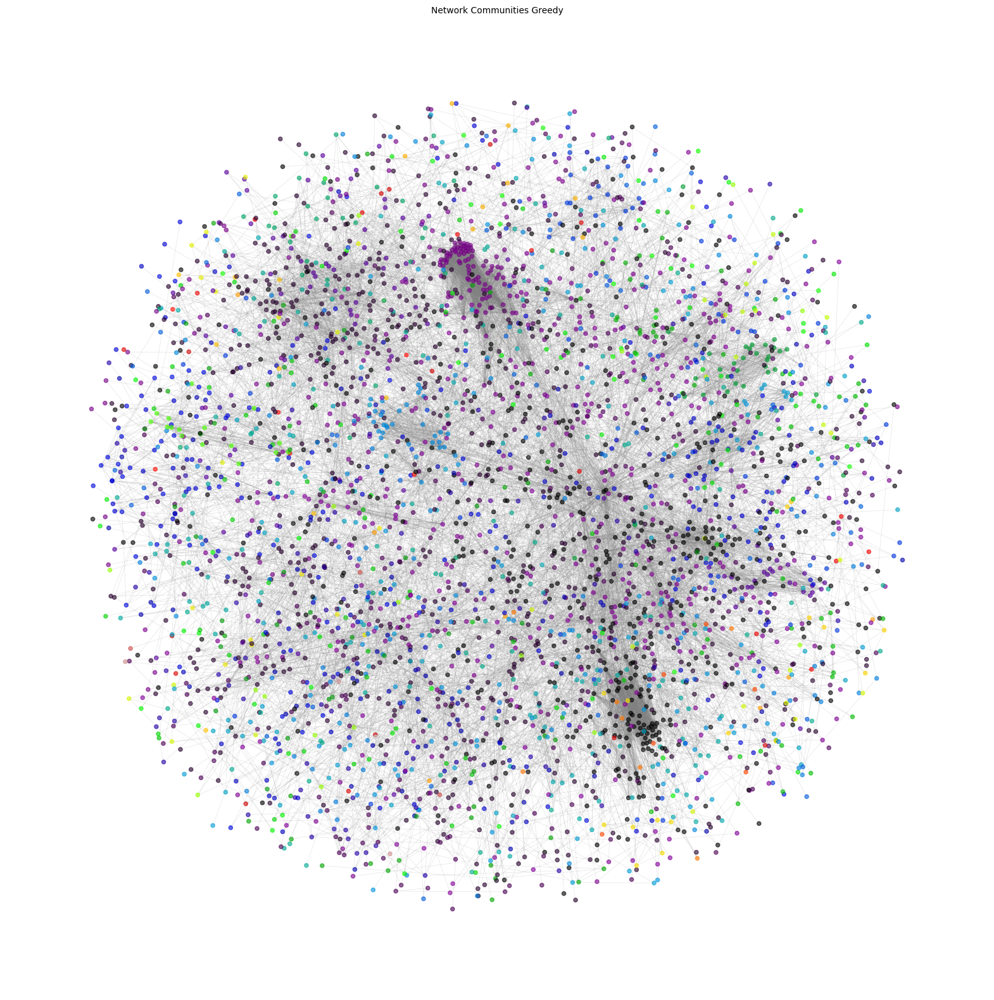

In [ ]:
# Create a layout for the nodes
pos = nx.spring_layout(G, k = 0.15)

# Create a color map with a unique color for each community
cmap = cmap = plt.cm.get_cmap('nipy_spectral')


# Set the size for the plot
plt.figure(figsize=(20,20))

# Draw the nodes, coloring them according to their community
node_color = [partition_greedy[node] for node in G.nodes()]
nx.draw_networkx_nodes(G, pos, node_size=20, cmap=cmap, node_color=node_color, alpha=0.6)


# Draw the edges
nx.draw_networkx_edges(G, pos, alpha=0.2, width=0.5, edge_color='grey')

plt.title('Network Communities Greedy', fontsize=10)  # add a title to the graph
plt.axis('off')  # remove axis for a cleaner look

plt.show()


In [141]:
# Calculate the size of each community for Greedy method
community_sizes_greedy = Counter(partition_greedy.values())
communities_greedy = [str(comm) for comm in community_sizes_greedy.keys()]
sizes_greedy = list(community_sizes_greedy.values())

In [144]:
# Function to create a sorted horizontal bar plot
def create_plot(communities, sizes, method):
    # Sort communities by size in descending order
    sorted_communities_sizes = sorted(zip(communities, sizes), key=lambda x: x[1], reverse=True)
    communities_sorted, sizes_sorted = zip(*sorted_communities_sizes)

    # Create the plot
    plt.figure(figsize=(20,20))
    plt.barh(communities_sorted, sizes_sorted)
    plt.ylabel("Community")
    plt.xlabel("Number of nodes")
    plt.title(f"Community Sizes ({method})")
    
    # Remove the top and left axes
    plt.gca().spines['top'].set_visible(False)
    plt.gca().spines['left'].set_visible(False)
    
    plt.gca().invert_yaxis()  # invert the y-axis to have the largest bar at the top
    plt.show()


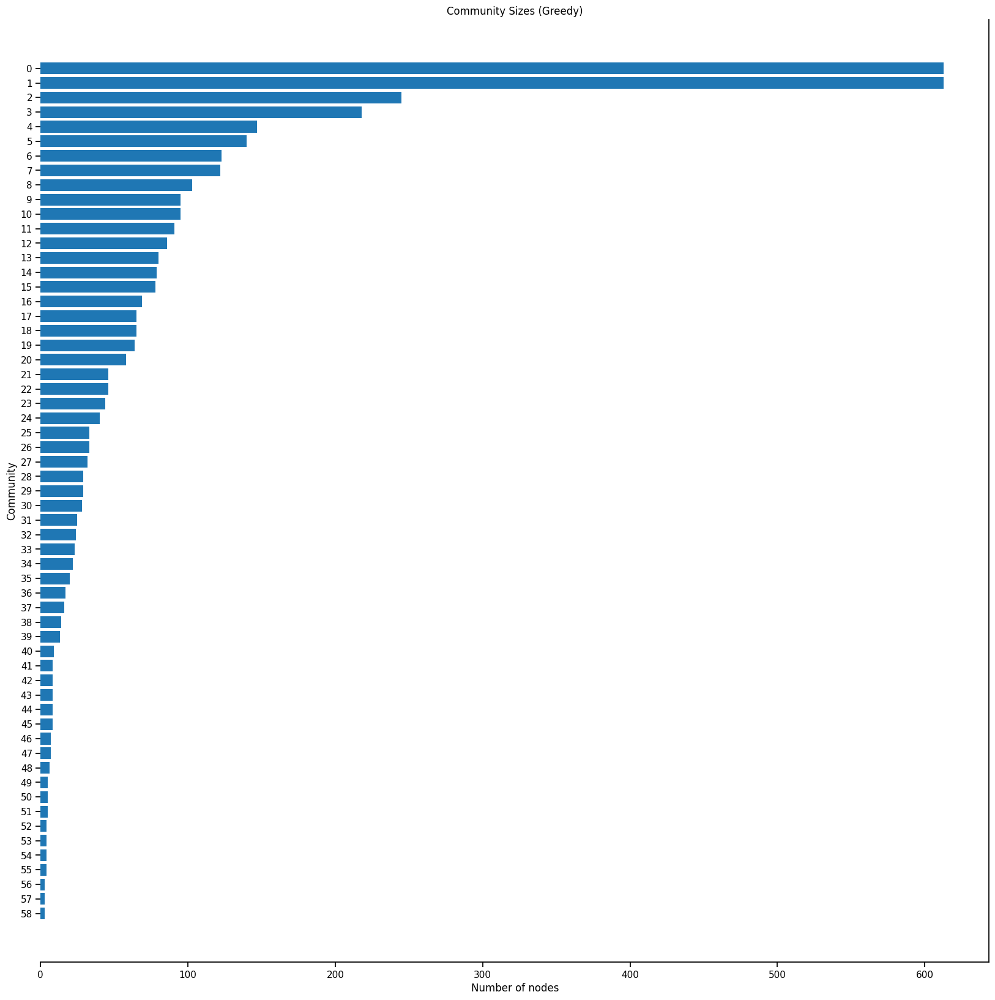

In [145]:
create_plot(communities_greedy, sizes_greedy, "Greedy")


We can see that we have two communities have the highest TV shows within their community. However there is a large different between these two communities and the subsequent one. For further analysis it would be worth inspecting more and assessing more characteristics about the shows. But for now we will just try to plot the first communuty as it and try to see how it is situated in the graph. 

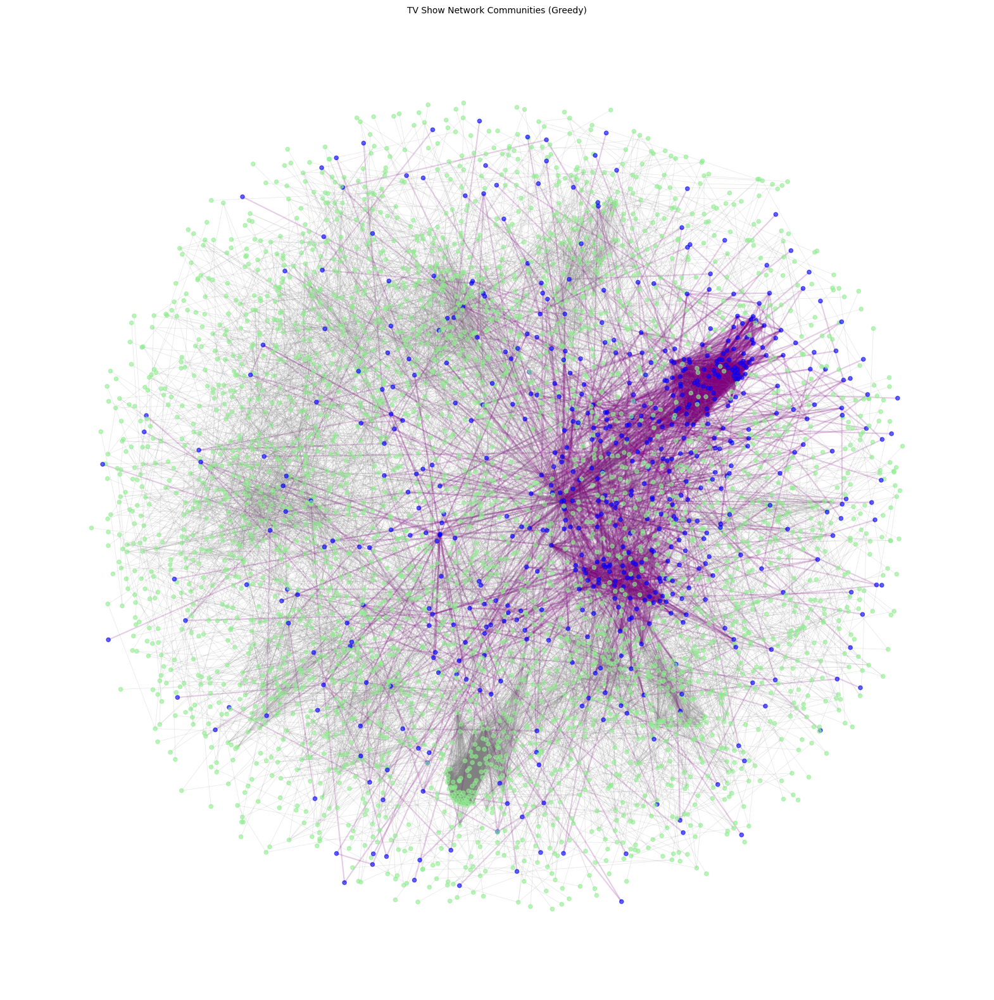

In [78]:
# Find the largest community
largest_community_greedy = max(list_community_sets_greedy, key=len)

# Create a set of all edges within the largest community
edges_within_largest_community = set()

for node in largest_community_greedy:
    for neighbor in G.neighbors(node):
        if neighbor in largest_community_greedy:
            edges_within_largest_community.add((node, neighbor))

# Create a layout for the nodes
pos = nx.spring_layout(G, k = 0.15)

# Color the nodes according to their community
color_map = []
size_map = []
node_index = {}

for node in G.nodes():
    if node not in largest_community_greedy:
        color_map.append('lightgreen')  # non-largest community nodes in light green
        size_map.append(20)  # smaller size for non-largest community nodes
    else:
        color_map.append('blue')  # largest community nodes in dark blue
        size_map.append(20)  # larger size for largest community nodes
        node_index[node] = node

plt.figure(figsize=(20,20))  # increase figure size for better visibility

# Draw nodes with specified colors and sizes
nx.draw_networkx_nodes(G, pos, node_size=size_map, node_color=color_map, alpha=0.6)

# Draw the edges, coloring them purple if they are within the largest community and increasing their width
edge_colors = []
edge_widths = []
for node1, node2 in G.edges():
    if (node1, node2) in edges_within_largest_community or (node2, node1) in edges_within_largest_community:
        edge_colors.append('purple')
        edge_widths.append(1.5)  # larger width for edges within the largest community
    else:
        edge_colors.append('grey')
        edge_widths.append(0.5)  # smaller width for other edges

nx.draw_networkx_edges(G, pos, alpha=0.2, edge_color=edge_colors, width=edge_widths)

# Draw labels for largest community nodes in white for contrast
#nx.draw_networkx_labels(G, labels=node_index, pos=pos, font_size=7, font_color='r')

plt.title('TV Show Network Communities (Greedy)', fontsize=10)  # add a title to the graph
plt.axis('off')  # remove axis for a cleaner look

plt.show()


### Louvain Method

The Louvain method is an algorithm for community detection in large networks. I shows how a network can divide naturally into groups of nodes in which dense connection are formed within groups and sparser connections are formed between groups. Based on the concept of modularity maximization, the Louvain method is an efficient greedy approach that scales to large graphs with up to one million nodes.

In [147]:
# Detect communities using the Louvain method
partition_library = community_louvain.best_partition(G)

In [148]:
# Get the list of communities
communities_louvain = list(partition_library.values())

# Calculate the number of communities
num_communities = len(set(communities_louvain))

# Calculate the size of each community
community_sizes = [communities_louvain.count(i) for i in range(num_communities)]

# Calculate the maximum, minimum, and average community size
max_size = max(community_sizes)
min_size = min(community_sizes)
avg_size = np.mean(community_sizes)

print(f"Number of communities: {num_communities}")
print(f"Maximum community size: {max_size}")
print(f"Minimum community size: {min_size}")
print(f"Average community size: {avg_size}")

Number of communities: 48
Maximum community size: 292
Minimum community size: 8
Average community size: 81.08333333333333


For the Louvain algorithm we have 46 number of communities with the maximum number of TV shows within a community being 281, which is smaller when compared to the Greedy algorithm. Furtehrmore we have minumum of 8 nodes within the smallest community and an average of 84, which are both higher when compared to the greedy algorithm. We will compare these two algorithm in terms of coverage, modularity and performance. But for now let us plot the Louvain by using different colors for the detected community. 

/var/folders/qg/q4wtx92x1kjfrg1x9bk3_v_w0000gn/T/ipykernel_34385/3971717436.py:5: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed two minor releases later. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap(obj)`` instead.
  cmap = cmap = plt.cm.get_cmap('nipy_spectral')


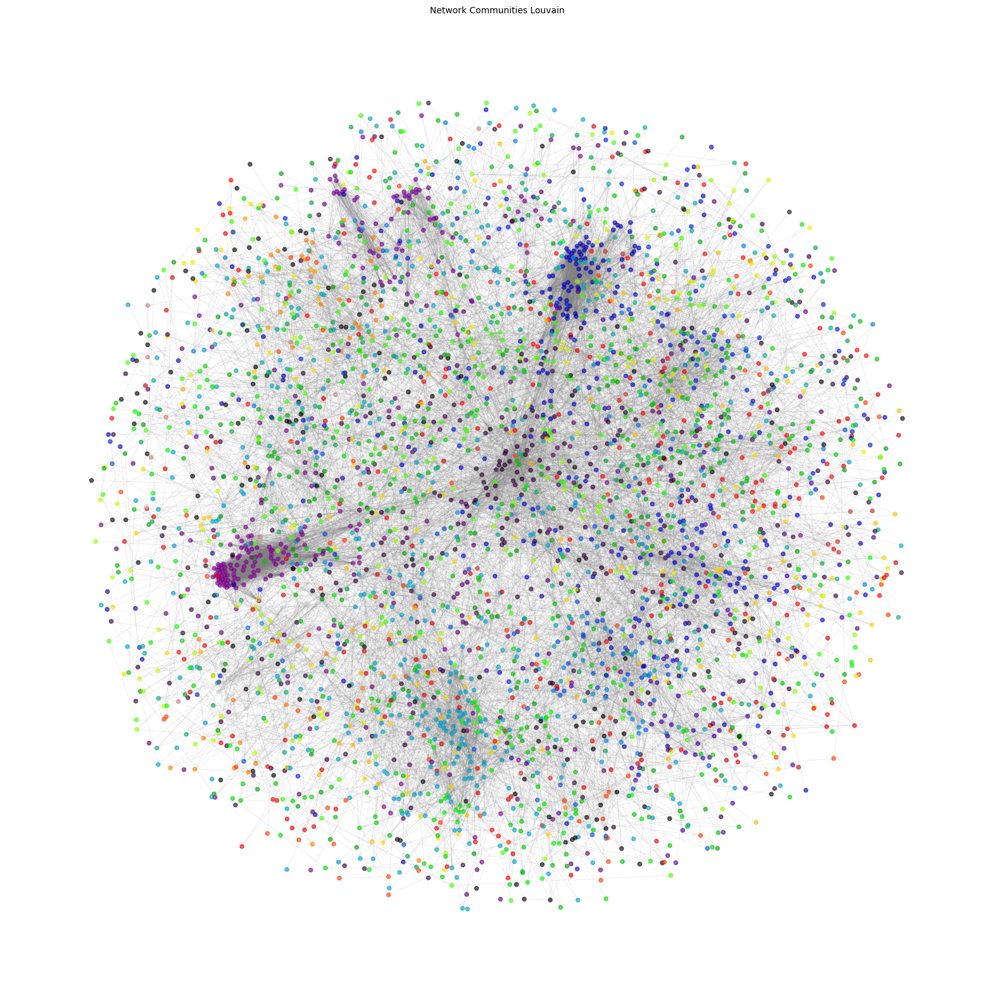

In [149]:
# Create a layout for the nodes
pos = nx.spring_layout(G, k = 0.15)

# Create a color map with a unique color for each community
cmap = cmap = plt.cm.get_cmap('nipy_spectral')

plt.figure(figsize=(20,20))

# Draw the nodes, coloring them according to their community
node_color = [partition_library[node] for node in G.nodes()]
nx.draw_networkx_nodes(G, pos, node_size=20, cmap=cmap, node_color=node_color, alpha=0.6)

# Draw the edges
nx.draw_networkx_edges(G, pos, alpha=0.2, width=0.5, edge_color='grey')


plt.title('Network Communities Louvain', fontsize=10)  # add a title to the graph
plt.axis('off')  # remove axis for a cleaner look

plt.show()


In [150]:
# Calculate the size of each community for Louvain method
community_sizes_louvain = Counter(partition_library.values())
communities_louvain = [str(comm) for comm in community_sizes_louvain.keys()]
sizes_louvain = list(community_sizes_louvain.values())

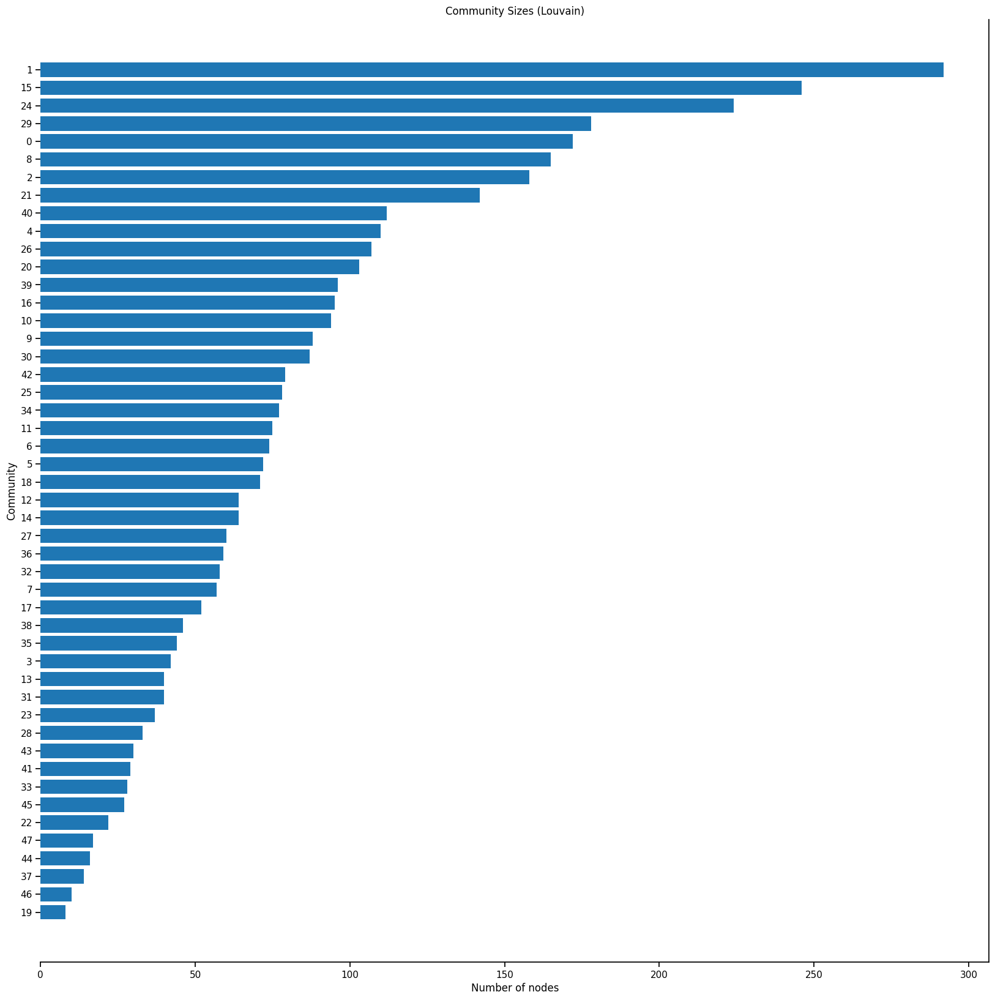

In [151]:
create_plot(communities_louvain, sizes_louvain, "Louvain")


/var/folders/qg/q4wtx92x1kjfrg1x9bk3_v_w0000gn/T/ipykernel_34385/3666552120.py:49: DeprecationWarning: `alltrue` is deprecated as of NumPy 1.25.0, and will be removed in NumPy 2.0. Please use `all` instead.
  nx.draw_networkx_edges(G, pos, alpha=0.2, edge_color=edge_colors, width=edge_widths)


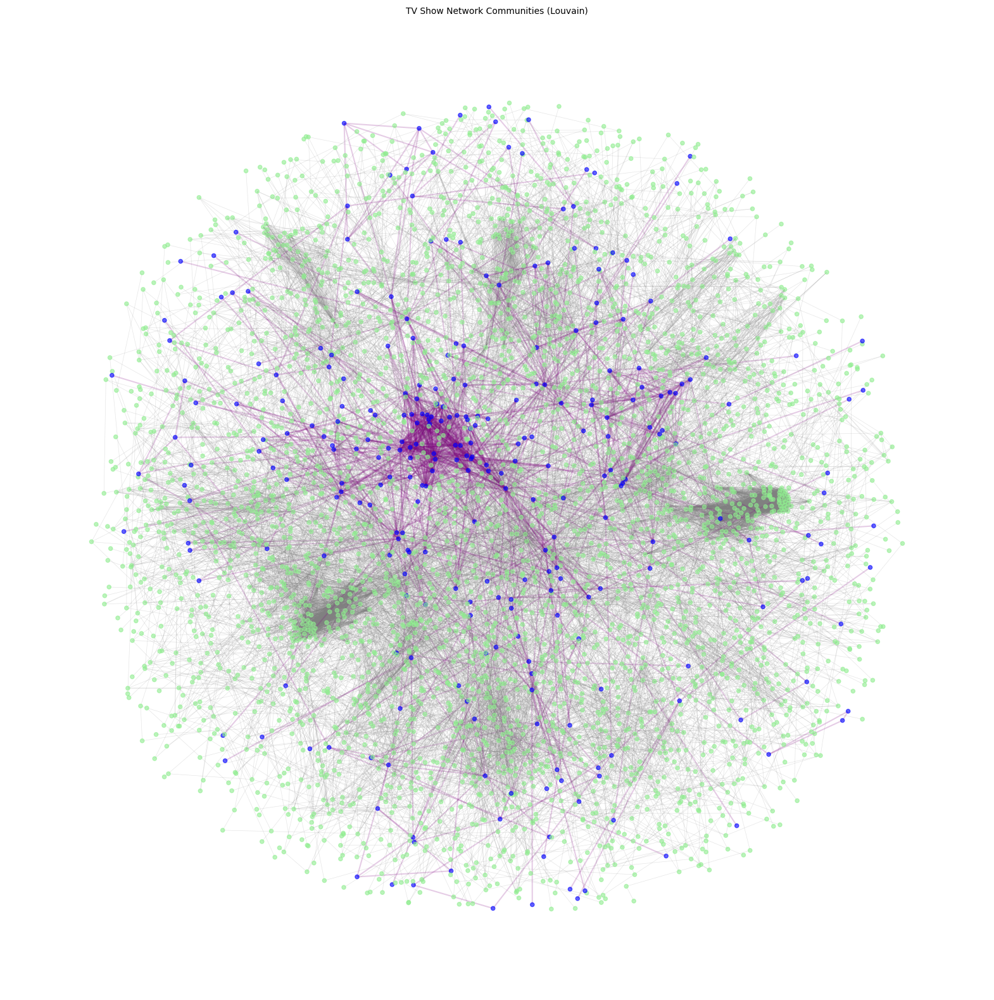

In [152]:
# Calculate the size of each community for Louvain method
community_sizes_louvain = Counter(partition_library.values())

# Find the largest community
largest_community_louvain = max(community_sizes_louvain.keys(), key=lambda x: community_sizes_louvain[x])

# Create a set of all edges within the largest community
edges_within_largest_community = set()

for node in G.nodes():
    if partition_library[node] == largest_community_louvain:
        for neighbor in G.neighbors(node):
            if partition_library[neighbor] == largest_community_louvain:
                edges_within_largest_community.add((node, neighbor))

# Create a layout for the nodes
pos = nx.spring_layout(G, k = 0.15)

# Color the nodes according to their community
color_map = []
size_map = []
node_index = {}

for node in G.nodes():
    if partition_library[node] != largest_community_louvain:
        color_map.append('lightgreen')  # non-largest community nodes in light green
        size_map.append(20)  # smaller size for non-largest community nodes
    else:
        color_map.append('blue')  # largest community nodes in dark blue
        size_map.append(20)  # larger size for largest community nodes
        node_index[node] = node

plt.figure(figsize=(20,20))  # increase figure size for better visibility

# Draw nodes with specified colors and sizes
nx.draw_networkx_nodes(G, pos, node_size=size_map, node_color=color_map, alpha=0.6)

# Draw the edges, coloring them purple if they are within the largest community and increasing their width
edge_colors = []
edge_widths = []
for node1, node2 in G.edges():
    if (node1, node2) in edges_within_largest_community or (node2, node1) in edges_within_largest_community:
        edge_colors.append('purple')
        edge_widths.append(1.5)  # larger width for edges within the largest community
    else:
        edge_colors.append('grey')
        edge_widths.append(0.5)  # smaller width for other edges

nx.draw_networkx_edges(G, pos, alpha=0.2, edge_color=edge_colors, width=edge_widths)

# Draw labels for largest community nodes in white for contrast
#nx.draw_networkx_labels(G, labels=node_index, pos=pos, font_size=7, font_color='r')

plt.title('TV Show Network Communities (Louvain)', fontsize=10)  # add a title to the graph
plt.axis('off')  # remove axis for a cleaner look

plt.show()


### Comparing Greedy & Louvain 

Now that we have conducted a greedy and louvain algorithm to detect community we will be assessing their coverage, modularity and performance. 

Coverage measures how mant of the edges in the network are contained within the detected communities. A high coverage indicated that more of the connectection are accounted for by the communities. The coverage will measure how many of the actual connections mutual likes between TV shows are represented within the communities. 

Performance is the intra-communitiy edges plus inter-community non-edges divided by the total number of potential edges. It measures how well the communities are seperatied from each other and how densly connected the nodes are within each community are. Where as the peformance measures how many possible connection within communities are actually present. Higher performance indicated that TV shows within each community are highly interconnected. 

Lastly, modularity measures the stength of division of a network into communities. It quantifies the idea that a random edge is less likely to fall within a community than we would expect by chance. A higher modularity menas network has a strong community structure. 

In [102]:
# Get unique community labels from the Louvain partition
comms = set(partition_library.values())

# Initialize an empty set for each community
list_community_sets_library = [ set() for _ in range(len(comms)) ]

# Assign nodes to their respective community sets
for node, community in partition_library.items():
    list_community_sets_library[community].add(node)


# List of community sets for both methods
community_sets_list = [list_community_sets_greedy,  list_community_sets_library]

for community_sets in community_sets_list:
    # Calculate and print coverage & performance
    coverage, performance = nx_comm.partition_quality(G, community_sets)
    print(f"Coverage: {coverage}")
    print(f"Performance : {performance}")   
    # Calculate and print modularity
    modularity = nx_comm.modularity(G, community_sets, weight='weight')
    print(f"Modularity: {modularity}")

    print("---")


Coverage: 0.9308544579151923
Performance : 0.9340917177041492
Modularity: 0.8268274681050948
---
Coverage: 0.9321306340274957
Performance : 0.9692120298694408
Modularity: 0.8723154485614274
---


Results indicate that the coverage is similar for both where as in terms of peformance and modularity the Louvain algorithm performs slightly higher than the greedy indicating the Louvain method's communities are slightly more interconnected and have a stonger community structure. 

The coverage are equal for both the Greedy and Louvain algorithm indicating that a large majority of the mutual likes between TV Shows are captured within the detected communities. This suggests that communities represent well the connections between TV Shows based on mutual likes.

 Where as the performance is higher for the Louvain when compared to the Greedy. This also indicates that communities are well seperated and densily connected. This shows that TV Shows within the same communty to be linked by mutal likes. 

Lastly modularity indicates also a high value for both but tends to be higher for the Louvain algrorithm indicating a stronger community structure. This means that the divion of TV shows into communities makes sense in terms of the structure of mutual likes. 

# Machine Learning 

### Recommendation System 

In order to build the recommendation system for our TV show network we will be using the Node2Vec algorithm. This would require us to embed nodes in using a biased random walks, which are a sequence of nodes that are randomly slected in a graph. This means we could consider the nodes that are closest to our nodes (Breadth-First Search) or nodes that are not adjacent to the previous nodes (Depth First Search). When we are conducting BFS we are exploiting the BFS we are emphasizing on structural equivalence and if we are emphasizing on DFS then we are focusing on homophily. So we will use our use both the BFS and DFS to create our dataset. 

The way we do this is we do this when we are sampling, we might create a node2vec to create vector embedding the nodes in the graph. These embedding then enable us to predict the structure of the network. So we will be utilising our graph G, then we will select a dimension of the node embedding, the walk length which represents the number of nodes in each walk, the number of walks we will be conducting per node and the two parameters p and q which are the bias enabling us to control the BFS and DFS aspect of our random walk.

When we focus on BFS when we it is ideal to emphasize structural equivalanece, which means that nodes are structurally equivalent if they share many of the same neighbors. Using this strategy random walks, nodes are often repeated and stay close to each other. So, if they share many neighbors, their structural equivalence will be higher. Homophily, on the other hand as seen previously, states that similar nodes are more likely to be connected. This enables us to emphasize on nodes that are far from the source and thus become less representative. So we will be experimenting beween these two and try and inspect the similarity that is within our TV show network. We will select news shows in order to test how our recommendation system works. 

In [44]:
def recommend(show, model):
  new_id = int(nodes[nodes.name == show].new_id.values[0])  # Convert new_id to int
  similar_shows = model.wv.most_similar(new_id)[:10]

  for show in similar_shows:
      title = show[0]
      similarity_index = show[1]
      print(f'{title}: {similarity_index:.2f}')


We have created a recommendation function that will take the name of the show we will be predicting for based on the model that we create which can differentiate based on the BFS or DFS aspect from the initial node. We will start with setting the p = 1 and the q = 1, which means that we are focusing on the BFS and DFS equivalent weight. 

In [45]:
# Node2Vec 1
node2vec = Node2Vec(G, dimensions = 100, walk_length= 20, num_walks = 200, p = 1, q = 1, workers = 1)

Computing transition probabilities:   0%|          | 0/3892 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 200/200 [01:40<00:00,  1.99it/s]


In [46]:
model = node2vec.fit(window = 10, min_count = 1, batch_words = 4)

In [47]:
model.wv.most_similar(3429)[:5]

[('Breadwinners', 0.9511173963546753),
 ('Midnight, Texas', 0.9442752003669739),
 ('Ninja Warrior', 0.9421012997627258),
 ('STRONG', 0.9412647485733032),
 ('Heartbeat', 0.939253032207489)]

In [48]:
recommend("CBS Evening News with Jeff Glor", model)

Big Love: 0.94
Enlightened: 0.89
Tout peut arriver: 0.89
Off Camera: 0.87
Hard Knocks: 0.87
Summer Heights High on HBO: 0.87
The No.1 Ladies' Detective Agency on HBO: 0.87
Bored to Death: 0.87
Band of Brothers: 0.86
Hung: 0.86


In [49]:
recommend("101 East - Al Jazeera", model)

Kapuso Mo, Jessica Soho (One at Heart, Jessica Soho): 0.93
Unang Hirit: 0.92
Investigative Documentaries: 0.92
Reporter's Notebook: 0.91
News to Go: 0.91
24 Oras: 0.91
Nosotros Los Guapos: 0.90
Wish Ko Lang: 0.90
Magpakailanman: 0.90
I JUANder: 0.89


In the following model we can see that the model has recommends shows that we can acheive high similarity to "CBS Evening News with Jeff Glor" and "101 East - Al Jazeera" with values derived from the Node2Vec, which is a graph embedding that captured the network sturcture into vector space. So with a score of the top recommended shows for each of the shows being "Big Love" with 0.94 and "Kapuso Mo, Jessica Soho (One at Heart, Jessica Soho)" 0.93, we can see the similarity score is high. 

Can we increase the parameter and increase the similarity for our two sampled data. We will be increasing the value of p, which encourages DFS, in another word homophily. 

In [50]:
# Node2Vec 2
node2vec1 = Node2Vec(G, dimensions = 100, walk_length= 20, num_walks = 200, p = 2, q = 1, workers = 1)

Computing transition probabilities:   0%|          | 0/3892 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 200/200 [01:34<00:00,  2.13it/s]


In [51]:
model1 = node2vec.fit(window = 10, min_count = 1, batch_words = 4)

In [207]:
model1.wv.most_similar(3429)[:5]

[('Crafty Men', 0.9395747184753418),
 ('black-ish', 0.9119812846183777),
 ('The Daily Show', 0.8763490915298462),
 ('NYC-ARTS', 0.6586984992027283),
 ('The Voice of China 中国好声音', 0.6513047218322754)]

In [270]:
recommend("CBS Evening News with Jeff Glor", model)

Sunday Night Football on NBC: 0.97
Friday Night Fever: 0.94
WECT News: 0.86
NBC Sports Soccer: 0.84
NFL on ESPN: 0.78
NBC Sports: 0.70
SoundOFF Nation: 0.69
Westminster Kennel Club Dog Show: 0.67
AGT Auditions: 0.65
WRCB Eyewitness Sports: 0.64


In [277]:
recommend("101 East - Al Jazeera", model)

Fox News Sunday: 0.97
Neil Cavuto: 0.95
America's Newsroom: 0.95
90's House: 0.95
MediaBuzz: 0.94
Myanmar Idol: 0.94
FOX & Friends Weekend: 0.94
Fox & Friends First: 0.94
Happening Now: 0.94
Outnumbered Fox News: 0.93


We can see that the similarity score for the shows recommended increased seem to be higher than when we had p = 1 and q = 1.  So let us try to increase the value of p, and encourage homophily and see if we would get a better result. 

In [251]:
# Node2Vec 
node2vec2 = Node2Vec(G, dimensions = 100, walk_length= 20, num_walks = 200, p = 3, q = 1, workers = 1)

Computing transition probabilities:   0%|          | 0/3892 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 200/200 [01:35<00:00,  2.09it/s]


In [252]:
model2 = node2vec2.fit(window = 10, min_count = 1, batch_words = 4)

In [262]:
recommend("CBS Evening News with Jeff Glor", model2)

SEXY BEASTS: 0.97
Catfish: The TV Show: 0.91
Espías del Amor: 0.79
Tolerancia Cero: 0.75
Primer Plano: 0.74
Alerta Máxima CHV: 0.74
SQP CHV: 0.74
Manos al Fuego: 0.72
Cocineros Chilenos: 0.71
Festival de Viña: 0.70


In [289]:
recommend("101 East - Al Jazeera", model2)

Le Tricheur: 0.94
Un sur 2: 0.94
Signé M: 0.93
Fugueuse: 0.93
Fort Boyard TVA: 0.93
Les jeunes loups: 0.92
L'ÉTÉ INDIEN: 0.92
Les beaux malaises: 0.92
Salut Bonjour: 0.92
Refuge animal: 0.92


Setting p = 3, we could see that the value for the recommended shows decrease the similarity and that we do not have so many similar shows. So we will start by again increasing the BFS and focusing on the structural equivalence would enable us to compare the results with the BFS. 

In [271]:
# Node2Vec 
node2vec3 = Node2Vec(G, dimensions = 100, walk_length= 20, num_walks = 200, p =1, q = 2, workers = 1)

Computing transition probabilities:   0%|          | 0/3892 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 200/200 [01:28<00:00,  2.25it/s]


In [273]:
model3 = node2vec3.fit(window = 10, min_count = 1, batch_words = 4)

In [274]:
model3.wv.most_similar(3429)[:5]

[('Brigada', 0.9597694873809814),
 ('Ang Pinaka', 0.9538829922676086),
 ('Wagas', 0.952591598033905),
 ('Pop Talk', 0.951881468296051),
 ('Biyahe ni Drew', 0.9484825134277344)]

In [285]:
recommend("CBS Evening News with Jeff Glor", model3)

Eurovision Song Contest: 0.94
Söngvakeppnin: 0.90
RTP - Festival da Canção: 0.89
El Bienamado: 0.89
EMA - Eurovision Slovenia: 0.88
Eurovisie Songfestival: 0.87
Junior Eurovision Song Contest: 0.87
Eurovision France: 0.87
Eurovision Song Contest Italia: 0.86
Catastrophe (Amazon Original): 0.86


In [290]:
recommend("101 East - Al Jazeera", model3)

Sports Jeopardyǃ: 0.86
The Dan Patrick Show: 0.83
Sonoran Living: 0.77
CT Style: 0.76
Studio 512: 0.74
6abc Action News: 0.72
FYI Philly: 0.72
WDRB in the Morning: 0.71
Live with Kelly and Ryan: 0.70
Jeopardy!: 0.69


We could see that when compared with DFS the recommendation system with Node2Vec performs better rather than increasing BFS. Experimenting with two different values of the parameter p and q would be interesting for differnet samples. 